# Computational Imaging
### Gordon Hageman

### Homework 2


Your assignment for this week is to create notebook combining the various notebooks used to create figures in chapter 3 of our text. 

Figures 3.3, 3.6 and 3.8 compare Weiner, total variation and EM algorithms for image deblurring and denoising. Implement these algorithms for various types of blur and noise levels on images of our choice. Compare reconstructions with all three algorithms. Try Gaussian noise and also try (separately) Poisson noise assuming that the signal level is around 100 and then around 1000 photons per pixel. Try several different gaussian blur widths. Analyze the details of the reconstructions and also compare mean square error with original images. You should work with monochrome images for simplicity. 

Figures 3.4 and 3.5 compare ordinary least squares, truncated SVD, Tikhonov and LASSO reconstructions for sparse spectra. Repeat these simulations for several different spectra in the Chianti database using several different measurement matrices, including random, Hadamard and downsampling forward models. Try several different noise levels. Compare the performance of each of the regression algorithms for different measurement and noise models. 

Consider the demosiacing neural network described in Table 3.1. Train the network as described in the text. Try to find an app for your smart phone that allows recording of raw format images. If you are unable to do this, find some raw format images online. Try to demosaic these images using the neural network, compare your results with the phone's built in demosaicing algorithm. Try improving the network of table 3.1 by adding more layers or more convolutions per layer, train the network and compare results. Compare the neural demosaicing algorithm with demosiacing built into openCV, as in the text or with other demosaicing algorithms. The main point of this exercise is to gain experience training and using neural networks, so be sure to try several different variations on the network and training strategy. Discuss your experience training the network in your report. 



Citation:
MIT data set, and kodak data set were combined by Scott Thoesen and provided to me via github. Scott also helped me alot with the code and understanding throughout the homework.

“Deep Joint Demosaicking and DENOISING SIGGRAPH Asia 2016.” Deep Demosaicking, https://groups.csail.mit.edu/graphics/demosaicnet/index.html.

Sthoesen. “OPTI556/Images at Main · Sthoesen/OPTI556.” GitHub, https://github.com/sthoesen/OPTI556/tree/main/images.

djbradyAtOpticalSciencesArizona. “ComputationalImaging/computationalimaginghomework2.Ipynb at Master · Djbradyatopticalsciencesarizona/Computationalimaging.” GitHub, 6 Sept. 2022, https://github.com/djbradyAtOpticalSciencesArizona/computationalImaging/blob/master/inverseProblems/ComputationalImagingHomework2.ipynb.

Franzen, Richard W. True Color Kodak Images, http://r0k.us/graphics/kodak/. 




#Initiaize

In [93]:
import numpy as np
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers
from tensorflow.keras.datasets import cifar10
from tensorflow.keras.models import Model
import matplotlib.pyplot as plt
from scipy import interpolate as interp
from scipy.special import expit
from skimage import color, data, io, restoration, exposure
from skimage.restoration import denoise_tv_chambolle
from sklearn import linear_model
from sklearn.metrics import mean_squared_error
from google.colab import files
import imageio
from PIL import Image
import cv2
import os
from numpy import random
from skimage import io, transform
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 10]
tf.experimental_relax_shapes=True
from scipy.signal import convolve2d, convolve
from skimage import color, data, restoration, exposure
plt.rcParams.update({'font.size': 16})
from matplotlib.image import imread
!pip install rawpy
import rawpy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


####Mount Drive

In [94]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


# Part 1

###First image

In [ ]:
img = Image.open('/content/gdrive/MyDrive/nikon/DSC_0002.png').convert('L')
img.save('ee_greyscale.png')

In [ ]:
img

Output hidden; open in https://colab.research.google.com to view.

array([[0.16262447, 0.17264341, 0.20270023, ..., 0.49520435, 0.49520435,
        0.49514326],
       [0.17264341, 0.18266235, 0.18266235, ..., 0.50522329, 0.49520435,
        0.49514326],
       [0.16262447, 0.17258232, 0.15260553, ..., 0.49520435, 0.48518541,
        0.48518541],
       ...,
       [0.26702914, 0.2570102 , 0.2570102 , ..., 0.06316818, 0.09078136,
        0.11081923],
       [0.28706702, 0.2570102 , 0.24705236, ..., 0.08082351, 0.10080029,
        0.13085711],
       [0.28706702, 0.28706702, 0.23703342, ..., 0.08082351, 0.13085711,
        0.16091392]])

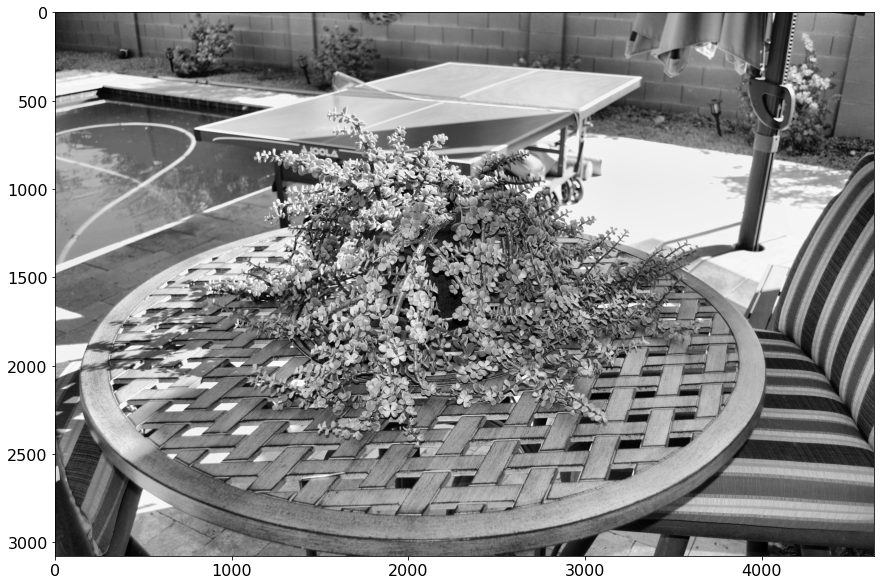

In [ ]:
elephant_ear = imread('/content/ee_greyscale.png')
elephant_ear=exposure.equalize_adapthist(elephant_ear)
plt.imshow(elephant_ear,cmap='gray')
elephant_ear

Text(0.5, 1.0, 'Wiener Filtered Image')

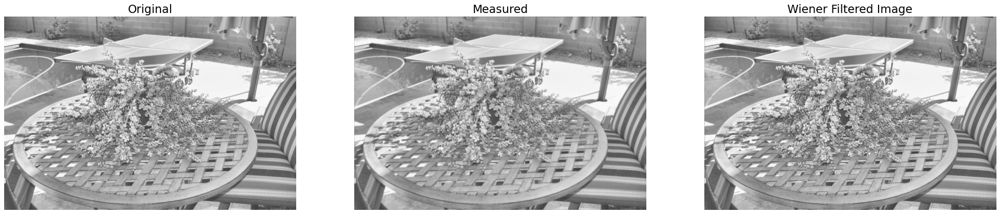

In [ ]:
# convolve with sampling psf
snr=10
xrange=np.linspace(-3,3,32)
x,y=np.meshgrid(xrange,xrange)
psf = np.exp(-(x**2+y**2))
psf=psf/np.sum(np.sum(psf))
snaked = convolve2d(elephant_ear, psf, 'same')
#add noise
snaked += elephant_ear.std() * np.random.standard_normal(elephant_ear.shape)/snr

deconvolved = restoration.wiener(snaked, psf,1/snr)

fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 10),
                       sharex=True, sharey=True)

plt.gray()

ax[0].imshow(elephant_ear, vmin=deconvolved.min(), vmax=deconvolved.max())
ax[0].axis('off')
ax[0].set_title('Original')
ax[1].imshow(snaked, vmin=deconvolved.min(), vmax=deconvolved.max())
ax[1].axis('off')
ax[1].set_title('Measured')
ax[2].imshow(deconvolved)
ax[2].axis('off')
ax[2].set_title('Wiener Filtered Image')

Text(0.5, 1.0, 'TV Restored')

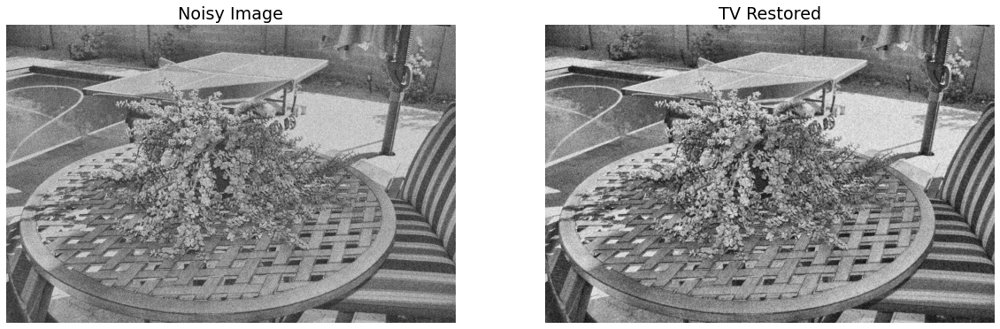

In [ ]:
from skimage.restoration import denoise_tv_chambolle
from skimage import color, data, restoration, exposure, filters
from skimage.util import random_noise

sigma = .5
snake = random_noise(elephant_ear, var=sigma**2)
denoised = denoise_tv_chambolle(snake, weight=0.2)
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 10),
                       sharex=True, sharey=True)

plt.gray()

ax[0].imshow(snake)
ax[0].axis('off')
ax[0].set_title('Noisy Image')
ax[1].imshow(denoised)
ax[1].axis('off')
ax[1].set_title('TV Restored')

Text(0.5, 1.0, 'TV Detail')

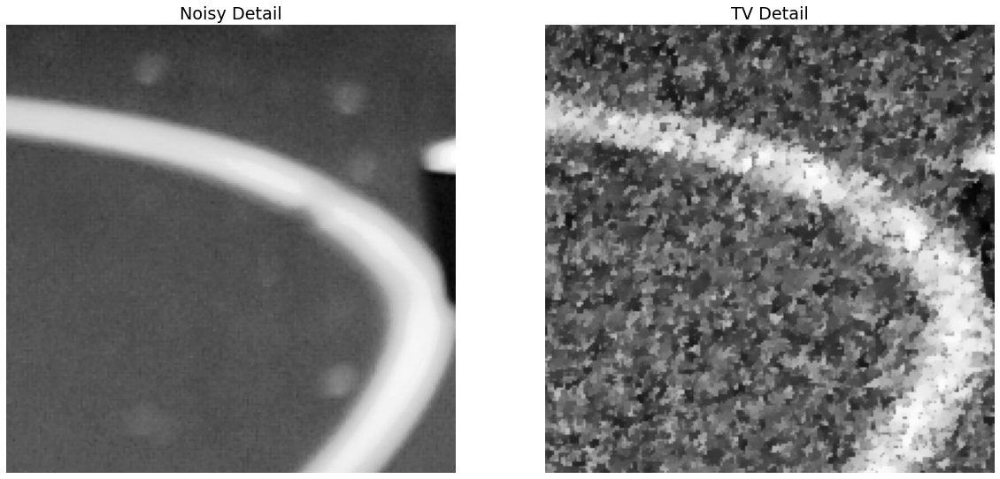

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 10),
                       sharex=True, sharey=True)

plt.gray()

ax[0].imshow(elephant_ear[600:800,600:800])
ax[0].axis('off')
ax[0].set_title('Noisy Detail')
ax[1].imshow(denoised[600:800,600:800])
ax[1].axis('off')
ax[1].set_title('TV Detail')

Text(0.5, 1.0, 'EM Deconvolved Image')

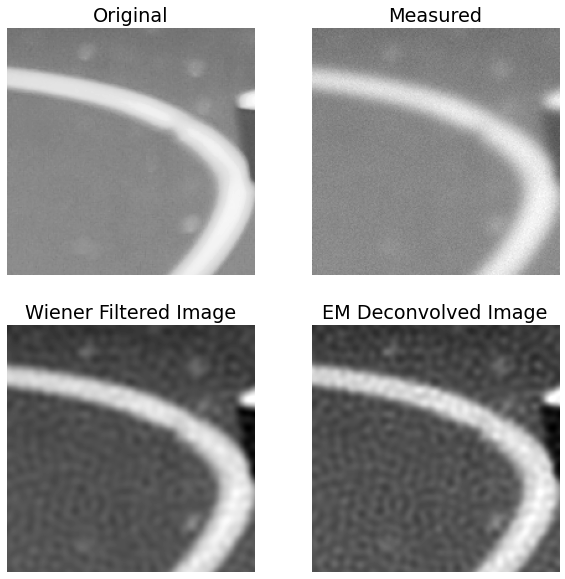

In [ ]:
# convolve with sampling psf
snr=10
snake = elephant_ear
xrange=np.linspace(-3,3,32)
x,y=np.meshgrid(xrange,xrange)
psf = np.exp(-(x**2+y**2))
psf=psf/np.sum(np.sum(psf))
snaked = convolve2d(snake, psf, 'same')
#add noise
snaked += snake.std() * np.random.standard_normal(snake.shape)/snr

deconvolved = restoration.wiener(snaked, psf,1/snr)
deconvolvedRL=restoration.richardson_lucy(snaked, psf, iterations=100)

fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(10, 10),
                       sharex=True, sharey=True)

plt.gray()

ax[0,0].imshow(snake[600:800,600:800], vmin=deconvolved.min(), vmax=deconvolved.max())
ax[0,0].axis('off')
ax[0,0].set_title('Original')
ax[0,1].imshow(snaked[600:800,600:800], vmin=deconvolved.min(), vmax=deconvolved.max())
ax[0,1].axis('off')
ax[0,1].set_title('Measured')
ax[1,0].imshow(deconvolved[600:800,600:800])
ax[1,0].axis('off')
ax[1,0].set_title('Wiener Filtered Image')
ax[1,1].imshow(deconvolvedRL[600:800,600:800])
ax[1,1].axis('off')
ax[1,1].set_title('EM Deconvolved Image')

array([[[0.20140459, 0.17086302, 0.13849135],
        [0.21141985, 0.18959916, 0.14244719],
        [0.22143511, 0.20881794, 0.14600289],
        ...,
        [0.5589618 , 0.47995207, 0.38114664],
        [0.54894656, 0.46532923, 0.3902782 ],
        [0.54894656, 0.46595407, 0.4029567 ]],

       [[0.20140459, 0.1770297 , 0.13560031],
        [0.22143511, 0.19626425, 0.1490297 ],
        [0.22143511, 0.19608137, 0.15262185],
        ...,
        [0.5589618 , 0.4815691 , 0.38937336],
        [0.54894656, 0.47412702, 0.3749501 ],
        [0.54894656, 0.47231856, 0.3868752 ]],

       [[0.20140459, 0.17911433, 0.13477552],
        [0.21141985, 0.1825285 , 0.1381411 ],
        [0.20140459, 0.17290205, 0.13271946],
        ...,
        [0.528916  , 0.4657922 , 0.37983233],
        [0.51896185, 0.45847356, 0.36632356],
        [0.51890075, 0.45910648, 0.3598223 ]],

       ...,

       [[0.24025644, 0.24354199, 0.2254486 ],
        [0.25355726, 0.24248458, 0.2303441 ],
        [0.26351145, 0

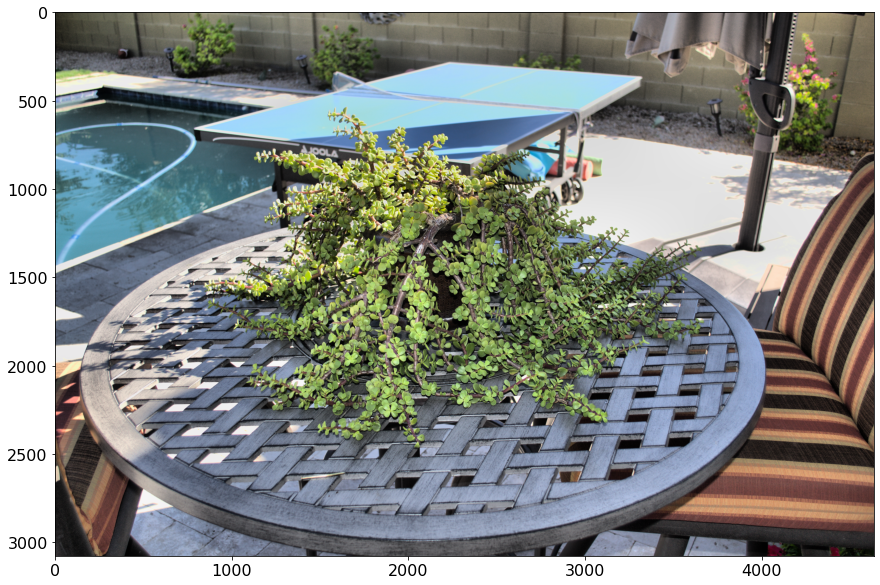

In [ ]:
elephant_ear = imread('/content/gdrive/MyDrive/nikon/DSC_0002.png')
elephant_ear=exposure.equalize_adapthist(elephant_ear)
plt.imshow(elephant_ear,cmap='gray')
elephant_ear

###Second Image

In [ ]:
img = Image.open('/content/gdrive/MyDrive/100CANON/IMG_8732.JPG')
img.save('blur.jpg')
img

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
img = Image.open('/content/gdrive/MyDrive/100CANON/IMG_8732.JPG').convert('L')
img.save('blur_greyscale.jpg')
img

Output hidden; open in https://colab.research.google.com to view.

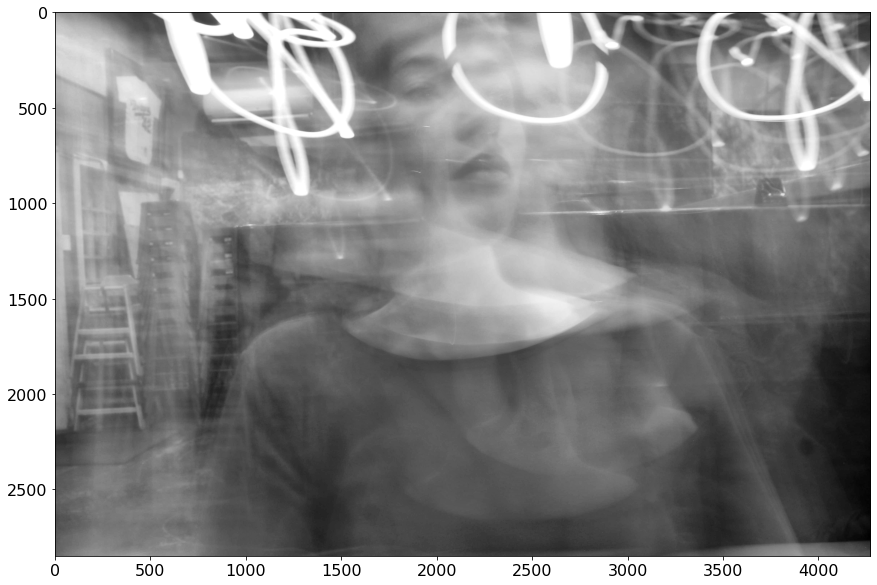

In [ ]:
snake=imread('/content/blur_greyscale.jpg')
snake=exposure.equalize_adapthist(snake)
plt.imshow(snake,cmap='gray')

Text(0.5, 1.0, 'Wiener Filtered Image')

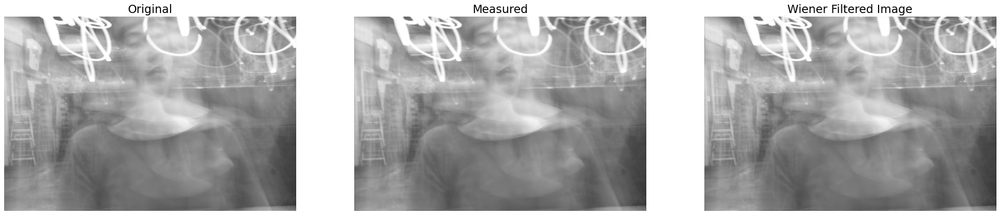

In [ ]:
# convolve with sampling psf
snr=10
xrange=np.linspace(-3,3,32)
x,y=np.meshgrid(xrange,xrange)
psf = np.exp(-(x**2+y**2))
psf=psf/np.sum(np.sum(psf))
snaked = convolve2d(snake, psf, 'same')
#add noise
snaked += snake.std() * np.random.standard_normal(snake.shape)/snr

deconvolved = restoration.wiener(snaked, psf,1/snr)

fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 10),
                       sharex=True, sharey=True)

plt.gray()

ax[0].imshow(snake, vmin=deconvolved.min(), vmax=deconvolved.max())
ax[0].axis('off')
ax[0].set_title('Original')
ax[1].imshow(snaked, vmin=deconvolved.min(), vmax=deconvolved.max())
ax[1].axis('off')
ax[1].set_title('Measured')
ax[2].imshow(deconvolved)
ax[2].axis('off')
ax[2].set_title('Wiener Filtered Image')

Text(0.5, 1.0, 'TV Restored')

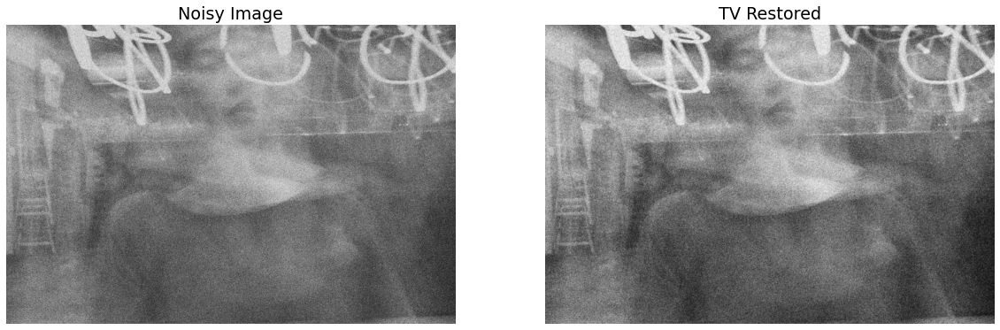

In [ ]:
from skimage.restoration import denoise_tv_chambolle
from skimage import color, data, restoration, exposure, filters
from skimage.util import random_noise
snake=imread('/content/blur_greyscale.jpg')
snake=exposure.equalize_adapthist(snake)

sigma = .5
snake = random_noise(snake, var=sigma**2)
denoised = denoise_tv_chambolle(snake, weight=0.2)
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 10),
                       sharex=True, sharey=True)

plt.gray()

ax[0].imshow(snake)
ax[0].axis('off')
ax[0].set_title('Noisy Image')
ax[1].imshow(denoised)
ax[1].axis('off')
ax[1].set_title('TV Restored')

Text(0.5, 1.0, 'TV Detail')

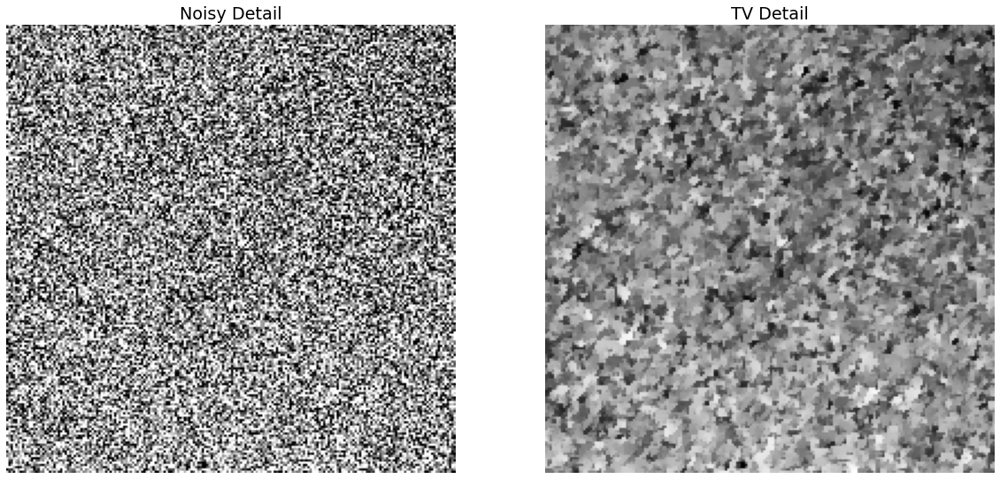

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 10),
                       sharex=True, sharey=True)

plt.gray()

ax[0].imshow(snake[600:800,600:800])
ax[0].axis('off')
ax[0].set_title('Noisy Detail')
ax[1].imshow(denoised[600:800,600:800])
ax[1].axis('off')
ax[1].set_title('TV Detail')

Text(0.5, 1.0, 'EM Deconvolved Image')

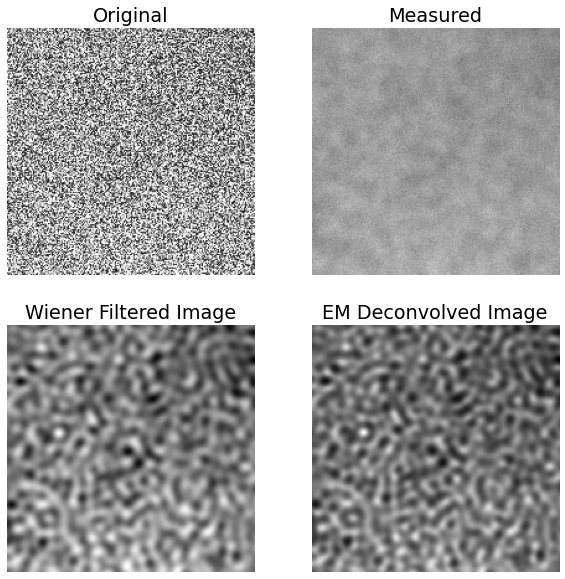

In [ ]:
# convolve with sampling psf
snr=10
xrange=np.linspace(-3,3,32)
x,y=np.meshgrid(xrange,xrange)
psf = np.exp(-(x**2+y**2))
psf=psf/np.sum(np.sum(psf))
snaked = convolve2d(snake, psf, 'same')
#add noise
snaked += snake.std() * np.random.standard_normal(snake.shape)/snr

deconvolved = restoration.wiener(snaked, psf,1/snr)
deconvolvedRL=restoration.richardson_lucy(snaked, psf, iterations=100)

fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(10, 10),
                       sharex=True, sharey=True)

plt.gray()

ax[0,0].imshow(snake[600:800,600:800], vmin=deconvolved.min(), vmax=deconvolved.max())
ax[0,0].axis('off')
ax[0,0].set_title('Original')
ax[0,1].imshow(snaked[600:800,600:800], vmin=deconvolved.min(), vmax=deconvolved.max())
ax[0,1].axis('off')
ax[0,1].set_title('Measured')
ax[1,0].imshow(deconvolved[600:800,600:800])
ax[1,0].axis('off')
ax[1,0].set_title('Wiener Filtered Image')
ax[1,1].imshow(deconvolvedRL[600:800,600:800])
ax[1,1].axis('off')
ax[1,1].set_title('EM Deconvolved Image')

###Third image

In [ ]:
img = Image.open('/content/gdrive/MyDrive/100CANON/IMG_8693.JPG').convert('L')
img.save('forest_g.jpg')
img

Output hidden; open in https://colab.research.google.com to view.

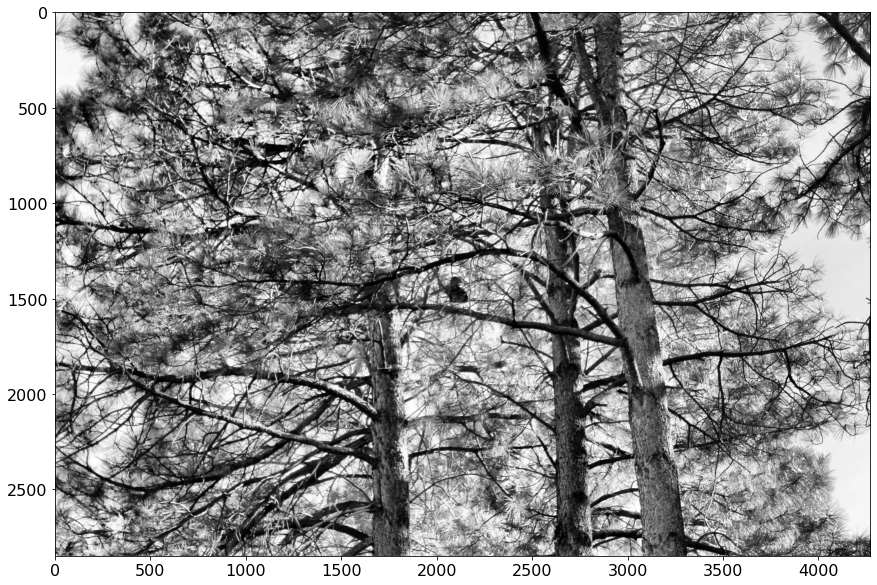

In [ ]:
snake=imread('/content/forest_g.jpg')
snake=exposure.equalize_adapthist(snake)
plt.imshow(snake,cmap='gray')

Text(0.5, 1.0, 'Wiener Filtered Image')

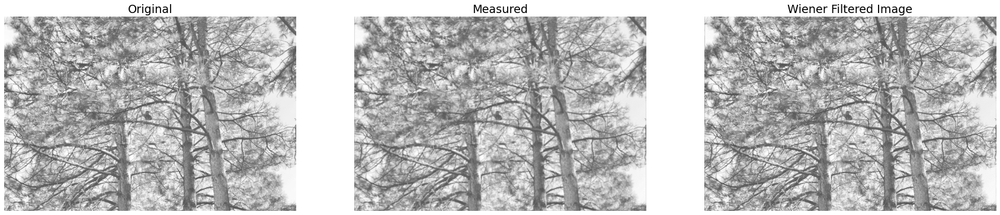

In [ ]:
# convolve with sampling psf
snr=10
xrange=np.linspace(-3,3,32)
x,y=np.meshgrid(xrange,xrange)
psf = np.exp(-(x**2+y**2))
psf=psf/np.sum(np.sum(psf))
snaked = convolve2d(snake, psf, 'same')
#add noise
snaked += snake.std() * np.random.standard_normal(snake.shape)/snr

deconvolved = restoration.wiener(snaked, psf,1/snr)

fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 10),
                       sharex=True, sharey=True)

plt.gray()

ax[0].imshow(snake, vmin=deconvolved.min(), vmax=deconvolved.max())
ax[0].axis('off')
ax[0].set_title('Original')
ax[1].imshow(snaked, vmin=deconvolved.min(), vmax=deconvolved.max())
ax[1].axis('off')
ax[1].set_title('Measured')
ax[2].imshow(deconvolved)
ax[2].axis('off')
ax[2].set_title('Wiener Filtered Image')

Text(0.5, 1.0, 'TV Restored')

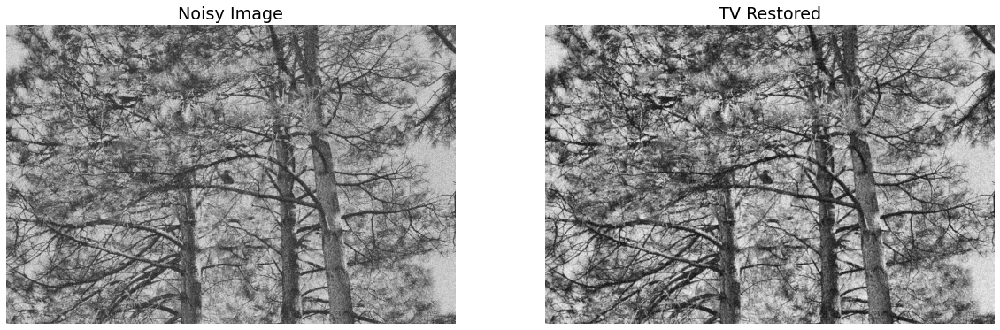

In [ ]:
snake=imread('/content/forest_g.jpg')
snake=exposure.equalize_adapthist(snake)

sigma = .5
snake = random_noise(snake, var=sigma**2)
denoised = denoise_tv_chambolle(snake, weight=0.2)
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 10),
                       sharex=True, sharey=True)

plt.gray()

ax[0].imshow(snake)
ax[0].axis('off')
ax[0].set_title('Noisy Image')
ax[1].imshow(denoised)
ax[1].axis('off')
ax[1].set_title('TV Restored')

Text(0.5, 1.0, 'TV Detail')

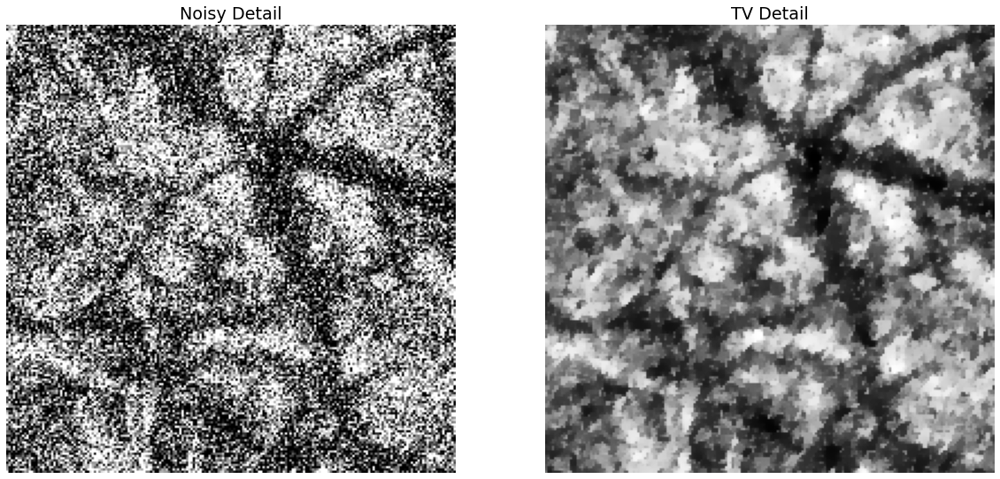

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 10),
                       sharex=True, sharey=True)

plt.gray()

ax[0].imshow(snake[600:800,600:800])
ax[0].axis('off')
ax[0].set_title('Noisy Detail')
ax[1].imshow(denoised[600:800,600:800])
ax[1].axis('off')
ax[1].set_title('TV Detail')

Now try this with Gaussian and Poisson noise assuming that the signal level is around 100 and then around 1000 photons per pixel. Try several different gaussian blur widths. Analyze the details of the reconstructions and also compare mean square error with original images. You should work with monochrome images for simplicity.

##Gaussian noise

####Point Spread Function

In [ ]:
# Create PSF
# This function will generate a PSF that is scale-invariant with respect to the example it comes from.
# This is done by preserving the aspect ratio and variance of the original when width is varied.
def getpsf(blurWidth):
  sigma = blurWidth/32 # preserve from example
  aspectRatio = 6/32 # preserve from example

  plim = int(aspectRatio*blurWidth/2)
  nlim = -plim

  xrange=np.linspace(nlim,plim,blurWidth)
  x,y=np.meshgrid(xrange,xrange)
  psf = np.exp(-(x**2+y**2)/(2*(sigma**2)/2))
  psf=psf/np.sum(np.sum(psf))
  return psf,sigma

####Elephant's Ear

In [ ]:
# Create PSF
psf, sigma = getpsf(blurWidth=32)

# Create SNR estimates
snr = [1,3,10,50]

snrRange = len(snr)

fig, ax = plt.subplots(nrows=snrRange, ncols=3,figsize=(30, 25))
plt.gray()

su = imread('/content/ee_greyscale.png')

for ii in range(snrRange):
  ax[ii,0].imshow(su)
  ax[ii,0].axis('off')
  ax[ii,0].set_title('Original')

  suConvolved = convolve2d(su, psf, 'same')
  # Gaussian noise is additive and scales with the std dev of the image
  suConvolved += su.std() * random.standard_normal(su.shape)/snr[ii]

  deconvolved = restoration.wiener(suConvolved, psf,1/snr[ii])
  deconvolved = np.clip(deconvolved,0.,1.)

  # compute MSE
  mse = mean_squared_error(su, deconvolved)

  ax[ii,1].imshow(suConvolved)
  ax[ii,1].axis('off')
  ax[ii,1].set_title('Measured (PSF_sigma=%1.2f, SNR=%i)' %(sigma,snr[ii]))
  ax[ii,2].imshow(deconvolved)
  ax[ii,2].axis('off')
  ax[ii,2].set_title('Wiener Filter (MSE=%f)' %mse)

Output hidden; open in https://colab.research.google.com to view.

####Blurry Girlfriend

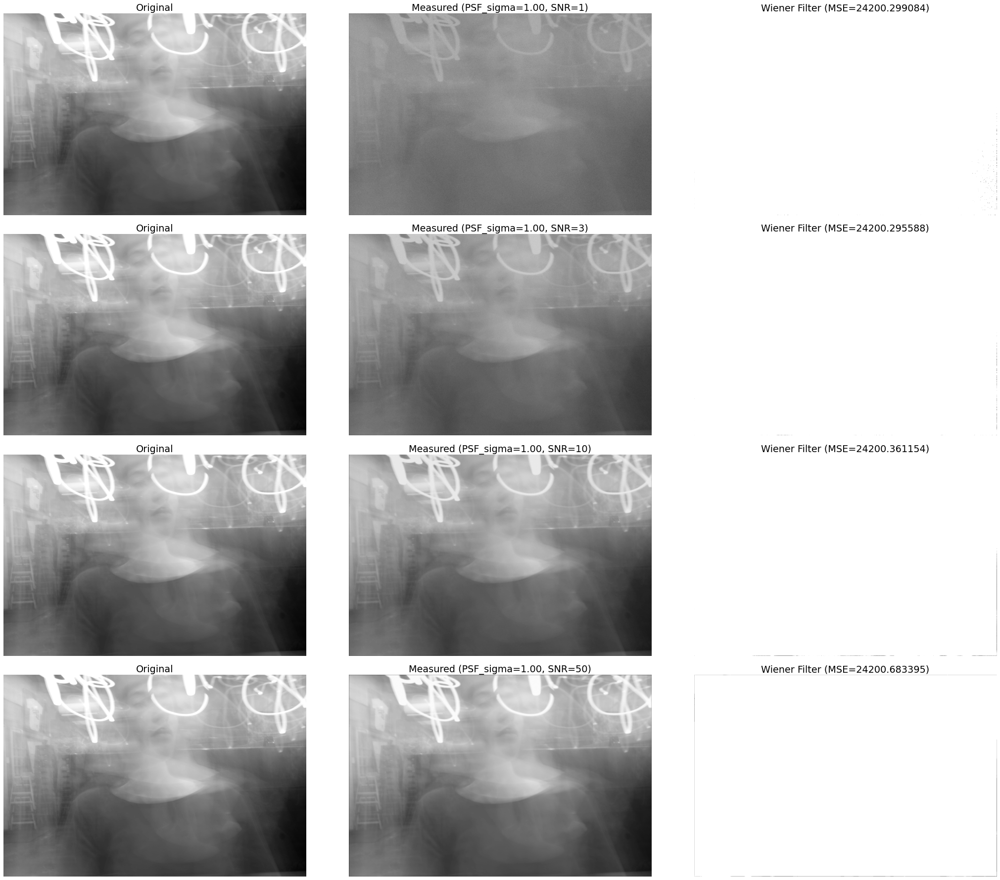

In [ ]:
# Create PSF
psf, sigma = getpsf(blurWidth=32)

# Create SNR estimates
snr = [1,3,10,50]

snrRange = len(snr)

fig, ax = plt.subplots(nrows=snrRange, ncols=3,figsize=(30, 25))
plt.gray()

su = imread('/content/blur_greyscale.jpg')

for ii in range(snrRange):
  ax[ii,0].imshow(su)
  ax[ii,0].axis('off')
  ax[ii,0].set_title('Original')

  suConvolved = convolve2d(su, psf, 'same')
  # Gaussian noise is additive and scales with the std dev of the image
  suConvolved += su.std() * random.standard_normal(su.shape)/snr[ii]

  deconvolved = restoration.wiener(suConvolved, psf,1/snr[ii])
  deconvolved = np.clip(deconvolved,0.,1.)

  # compute MSE
  mse = mean_squared_error(su, deconvolved)

  ax[ii,1].imshow(suConvolved)
  ax[ii,1].axis('off')
  ax[ii,1].set_title('Measured (PSF_sigma=%1.2f, SNR=%i)' %(sigma,snr[ii]))
  ax[ii,2].imshow(deconvolved)
  ax[ii,2].axis('off')
  ax[ii,2].set_title('Wiener Filter (MSE=%f)' %mse)

Not sure why the Wiener filter failed here. The image is likely too blurry for the algorithm to constuct an estimate of the desired target. The "desired target" might just be the white screen displayed.

###Anaylze blur

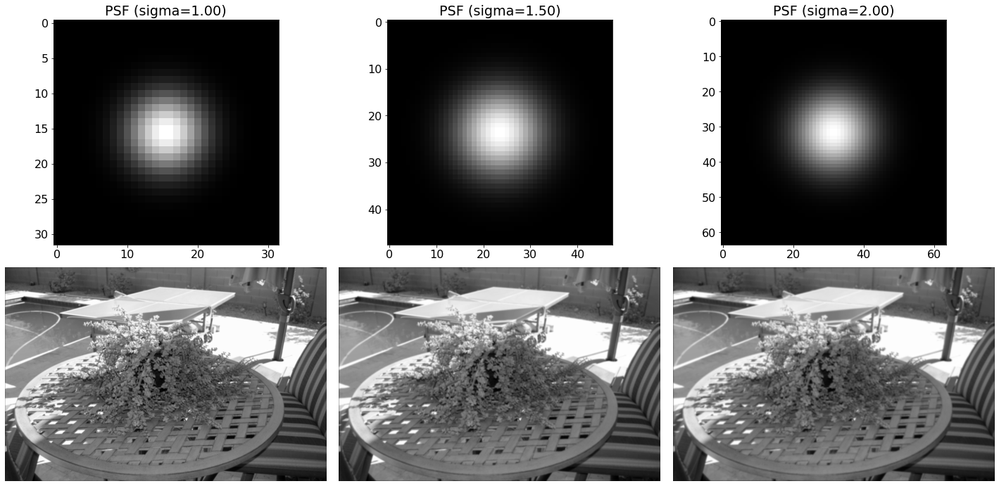

In [ ]:
# create list of widths
blurWidths = [32,48,64]

fig, ax = plt.subplots(nrows=2, ncols=len(blurWidths),figsize=(20, 10))
plt.gray()

su = imread('/content/ee_greyscale.png')

for ii in range(len(blurWidths)):

  # Create PSF
  psf, sigma = getpsf(blurWidth=blurWidths[ii])

  suConvolved = convolve2d(su, psf, 'same')

  ax[0,ii].set_title('PSF (sigma=%1.2f)' %(sigma))
  ax[0,ii].imshow(psf)

  ax[1,ii].imshow(suConvolved)
  ax[1,ii].axis('off')

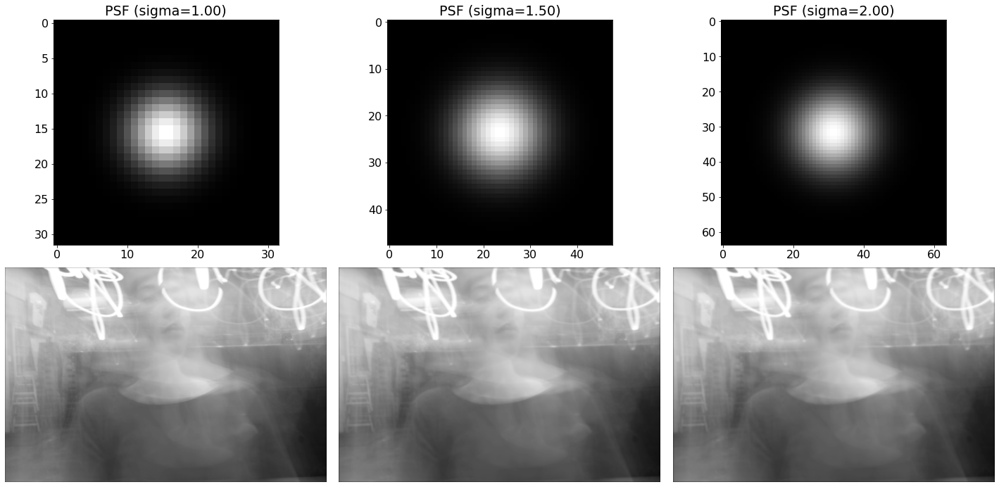

In [ ]:
# create list of widths
blurWidths = [32,48,64]

fig, ax = plt.subplots(nrows=2, ncols=len(blurWidths),figsize=(20, 10))
plt.gray()

su = imread('/content/blur_greyscale.jpg')

for ii in range(len(blurWidths)):

  # Create PSF
  psf, sigma = getpsf(blurWidth=blurWidths[ii])

  suConvolved = convolve2d(su, psf, 'same')

  ax[0,ii].set_title('PSF (sigma=%1.2f)' %(sigma))
  ax[0,ii].imshow(psf)

  ax[1,ii].imshow(suConvolved)
  ax[1,ii].axis('off')

##Possion noise

####Great Orion Nebula

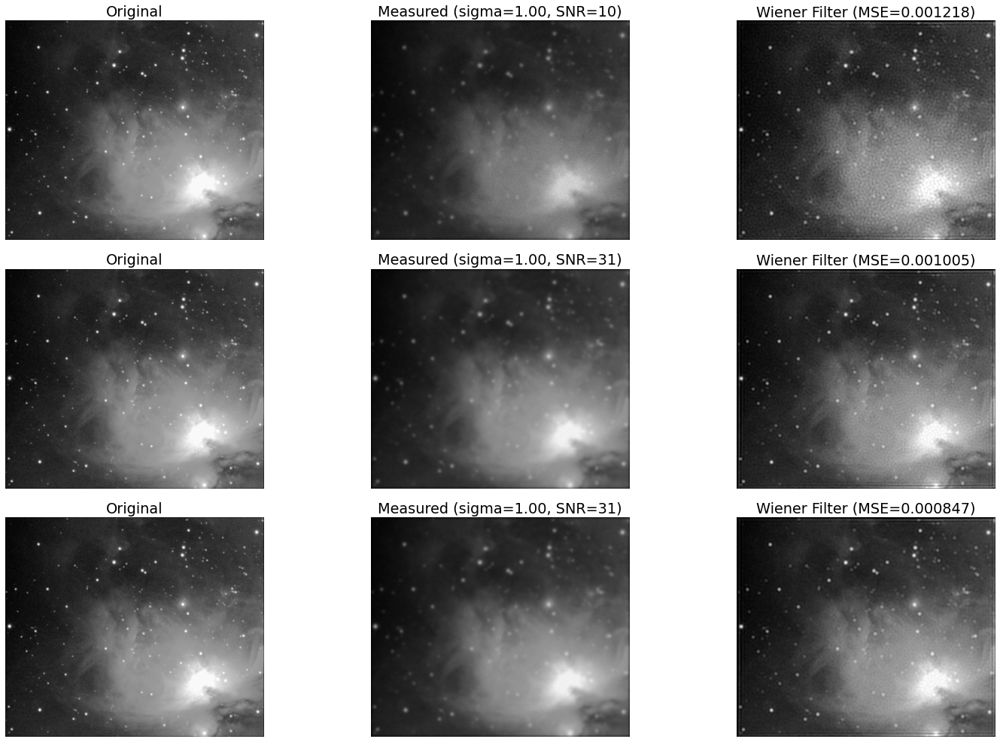

In [ ]:
# Create PSF
psf, sigma = getpsf(blurWidth=32)

# Create lambda values for Poisson noise
lam = [100,1000,1000]

lamRange = len(lam)

img = Image.open('/content/gdrive/MyDrive/pics/orion_0.5.jpeg').convert('L')
img.save('5_greyscale.png')

su = imread('/content/5_greyscale.png')

fig, ax = plt.subplots(nrows=lamRange, ncols=3,figsize=(21, 14))
plt.gray()

for ii in range(lamRange):
  ax[ii,0].imshow(su)
  ax[ii,0].axis('off')
  ax[ii,0].set_title('Original')

  # Poisson noise is signal dependent
  # compute ratio of expected number of photons/pixel to expected pixel
  #   value of the image for conversion
  r = lam[ii]/np.mean(su)

  suConvolved = convolve2d(su, psf, 'same')

  # use image itself as Poisson parameter
  # convert pixel values in order to estimate photon counts, via r
  # convert back to pixel values and use as noisy image
  suConvolved = random.poisson(r*suConvolved)/r

  snr = lam[ii]/np.sqrt(lam[ii])

  if ii == lamRange - 1:
  # underestimate SNR and see if a more aggressive filter improves reconstruction MSE
    deconvolved = restoration.wiener(suConvolved, psf,1/(snr-20))
  else:
    deconvolved = restoration.wiener(suConvolved, psf,1/snr)

  deconvolved = np.clip(deconvolved,0.,1.)
  
  # compute MSE
  mse = mean_squared_error(su, deconvolved)

  ax[ii,1].imshow(suConvolved)
  ax[ii,1].axis('off')
  ax[ii,1].set_title('Measured (sigma=%1.2f, SNR=%i)' %(sigma,snr))
  ax[ii,2].imshow(deconvolved)
  ax[ii,2].axis('off')
  ax[ii,2].set_title('Wiener Filter (MSE=%f)' %mse)

####NGC 6144

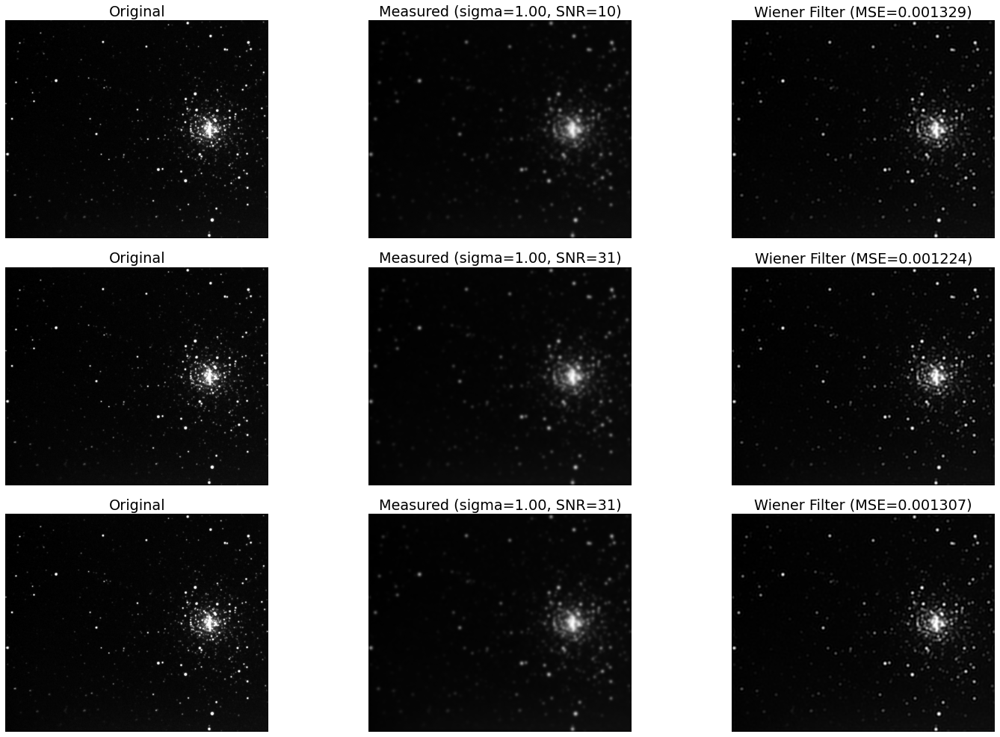

In [ ]:
# Create PSF
psf, sigma = getpsf(blurWidth=32)

# Create lambda values for Poisson noise
lam = [100,1000,1000]

lamRange = len(lam)

img = Image.open('/content/gdrive/MyDrive/pics/ngc6144.jpeg').convert('L')
img.save('ngc6144_greyscale.png')

su = imread('/content/ngc6144_greyscale.png')

fig, ax = plt.subplots(nrows=lamRange, ncols=3,figsize=(21, 14))
plt.gray()

for ii in range(lamRange):
  ax[ii,0].imshow(su)
  ax[ii,0].axis('off')
  ax[ii,0].set_title('Original')

  # Poisson noise is signal dependent
  # compute ratio of expected number of photons/pixel to expected pixel
  #   value of the image for conversion
  r = lam[ii]/np.mean(su)

  suConvolved = convolve2d(su, psf, 'same')

  # use image itself as Poisson parameter
  # convert pixel values in order to estimate photon counts, via r
  # convert back to pixel values and use as noisy image
  suConvolved = random.poisson(r*suConvolved)/r

  snr = lam[ii]/np.sqrt(lam[ii])

  if ii == lamRange - 1:
  # underestimate SNR and see if a more aggressive filter improves reconstruction MSE
    deconvolved = restoration.wiener(suConvolved, psf,1/(snr-20))
  else:
    deconvolved = restoration.wiener(suConvolved, psf,1/snr)

  deconvolved = np.clip(deconvolved,0.,1.)
  
  # compute MSE
  mse = mean_squared_error(su, deconvolved)

  ax[ii,1].imshow(suConvolved)
  ax[ii,1].axis('off')
  ax[ii,1].set_title('Measured (sigma=%1.2f, SNR=%i)' %(sigma,snr))
  ax[ii,2].imshow(deconvolved)
  ax[ii,2].axis('off')
  ax[ii,2].set_title('Wiener Filter (MSE=%f)' %mse)

#Part 2

In [97]:
!wget https://download.chiantidatabase.org/CHIANTI_10.0.1_database.tar.gz
!mkdir dbase
!tar xvf CHIANTI_10.0.1_database.tar.gz -C dbase/

--2022-09-28 03:29:43--  https://download.chiantidatabase.org/CHIANTI_10.0.1_database.tar.gz
Resolving download.chiantidatabase.org (download.chiantidatabase.org)... 70.32.23.63
Connecting to download.chiantidatabase.org (download.chiantidatabase.org)|70.32.23.63|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 888202017 (847M) [application/x-gzip]
Saving to: ‘CHIANTI_10.0.1_database.tar.gz.1’

CHIANTI_10.0.1_data 100%[===================>] 847.05M  52.8MB/s    in 16s     

2022-09-28 03:29:59 (51.6 MB/s) - ‘CHIANTI_10.0.1_database.tar.gz.1’ saved [888202017/888202017]

mkdir: cannot create directory ‘dbase’: File exists
README_CHIANTI
VERSION
abundance/
abundance/sun_coronal_2012_schmelz_ext.abund
abundance/cosmic_1973_allen.abund
abundance/sun_photospheric_2011_caffau.abund
abundance/sun_photospheric_2015_scott.abund
abundance/unity.abund
abundance/sun_coronal_1999_fludra_ext.abund
abundance/sun_photospheric_1998_grevesse.abund
abundance/sun_coronal_1992_feld

In [98]:
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files
from scipy.linalg import toeplitz
%matplotlib inline
plt.rcParams['figure.figsize'] = [30, 10]
plt.rcParams.update({'font.size': 22})
from sklearn import linear_model
from skimage import filters

In [99]:
!pip3 install ChiantiPy
!pip3 install ipyparallel
%env XUVTOP=/content/dbase/

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
env: XUVTOP=/content/dbase/


In [100]:
import ChiantiPy.core as ch

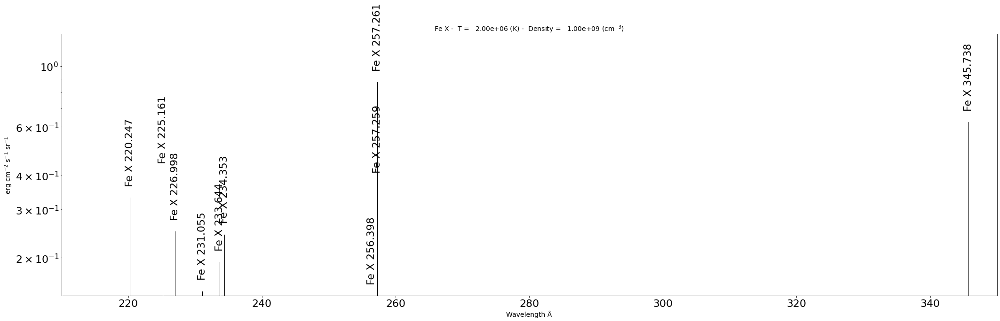

In [101]:
t=2000000
fe10 = ch.ion('fe_10', temperature=t, eDensity=1.e+9, em=1.e+27)
fe10.intensityPlot(wvlRange=[210.,350.],linLog='log')
wvl = np.linspace(100,400,1024)
fe10.spectrum(wvl)

Text(0.5, 1.0, 'True Spectrum for Fe10')

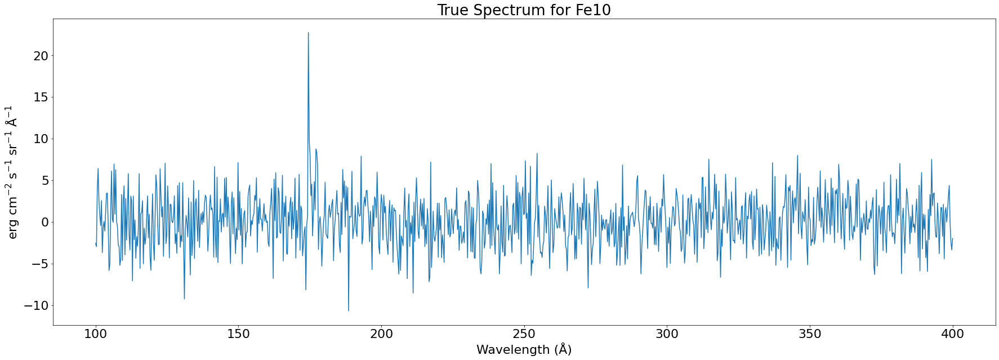

In [102]:
noiseLevel=3
trueSpectrumFe10 = fe10.Spectrum['intensity']+noiseLevel*np.random.normal(scale=1,size=(1024))
plt.plot(wvl,trueSpectrumFe10)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('True Spectrum for Fe10')

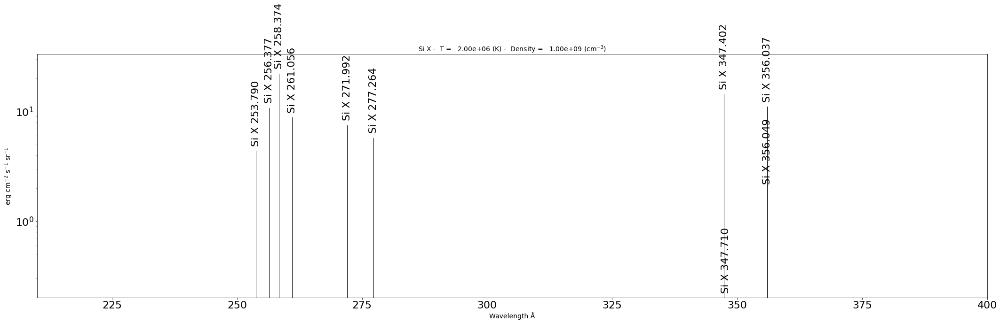

In [103]:
si10 = ch.ion('si_10', temperature=t, eDensity=1.e+9, em=1.e+27)
si10.intensityPlot(wvlRange=[210.,400.],linLog='log')
wvl = np.linspace(100,400,1024)
si10.spectrum(wvl)

Text(0.5, 1.0, 'True Spectrum for Si10')

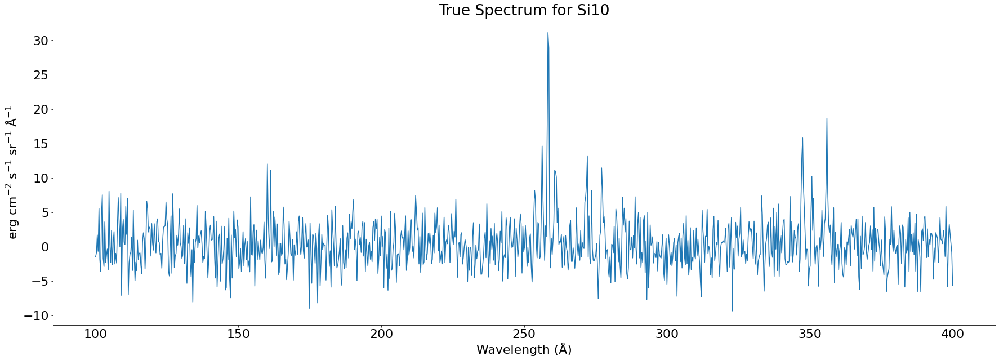

In [104]:
noiseLevel=3
trueSpectrumSi10 = si10.Spectrum['intensity']+noiseLevel*np.random.normal(scale=1,size=(1024))
plt.plot(wvl,trueSpectrumSi10)
plt.xlabel(si10.Spectrum['xlabel'])
plt.ylabel(si10.Spectrum['ylabel'])
plt.title('True Spectrum for Si10')

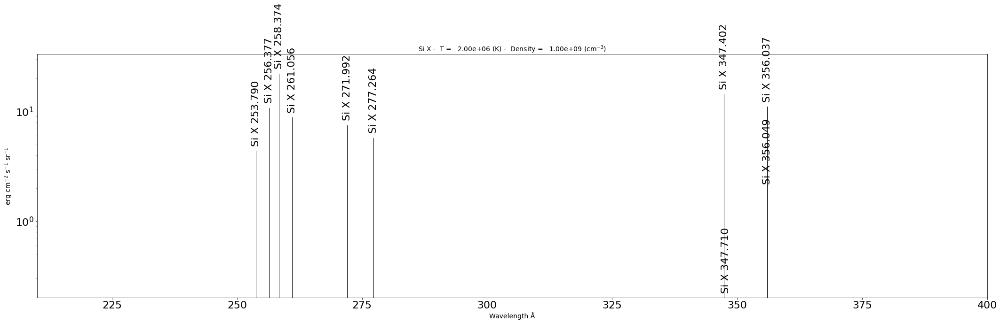

In [105]:
si10 = ch.ion('si_10', temperature=t, eDensity=1.e+9, em=1.e+27)
si10.intensityPlot(wvlRange=[210.,400.],linLog='log')
wvl = np.linspace(100,400,1024)
si10.spectrum(wvl)

Text(0.5, 1.0, 'True Spectrum for Si10')

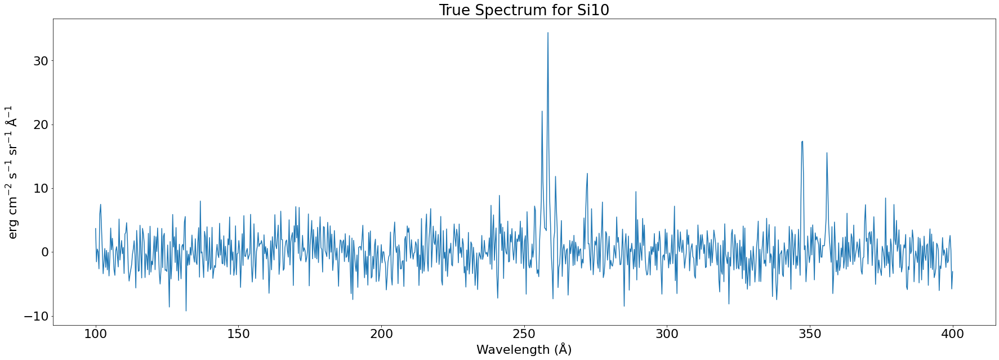

In [106]:
noiseLevel=3
trueSpectrumSi10 = si10.Spectrum['intensity']+noiseLevel*np.random.normal(scale=1,size=(1024))
plt.plot(wvl,trueSpectrumSi10)
plt.xlabel(si10.Spectrum['xlabel'])
plt.ylabel(si10.Spectrum['ylabel'])
plt.title('True Spectrum for Si10')

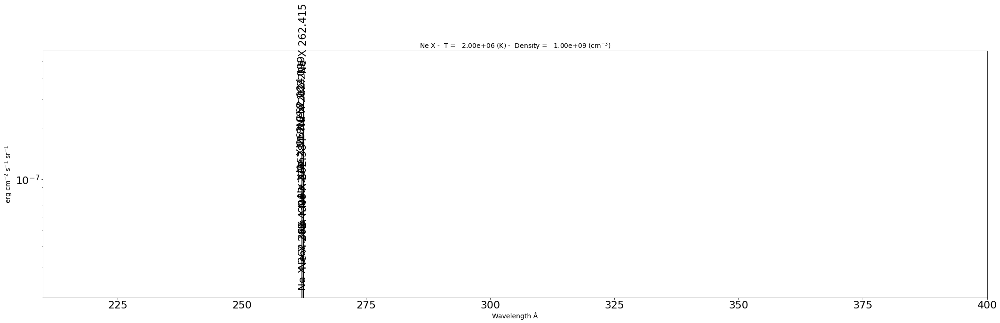

In [107]:
ne10 = ch.ion('ne_10', temperature=t, eDensity=1.e+9, em=1.e+27)
ne10.intensityPlot(wvlRange=[210.,400.],linLog='log')
wvl = np.linspace(100,400,1024)
ne10.spectrum(wvl)

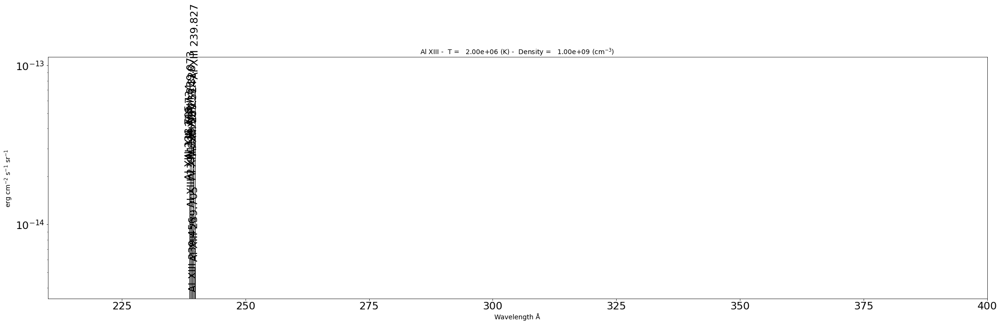

In [108]:
al13 = ch.ion('al_13', temperature=t, eDensity=1.e+9, em=1.e+27)
al13.intensityPlot(wvlRange=[210.,400.],linLog='log')
wvl = np.linspace(100,400,1024)
al13.spectrum(wvl)

In [109]:
#
# We are considering measurements of length 1024 spectra using $m\times 1024 $ random matricies
#
def plot(x):
  R=400
  noiseLevel=3
  H=np.random.random((R,1024))-.5
  y=np.matmul(H,x.Spectrum['intensity'])+noiseLevel*np.random.normal(scale=1,size=(R))
  plt.subplot(1,3,1)
  #fe=np.linalg.lstsq(H, y)[0]
  lpam=10
  fe=np.matmul(np.matmul(np.linalg.pinv(np.matmul(np.transpose(H),H)+lpam**2*np.eye(1024)),np.transpose(H)), y)
  plt.plot(wvl,fe)
  plt.xlabel(x.Spectrum['xlabel'])
  plt.ylabel(x.Spectrum['ylabel'])
  plt.title('Tikhonov Estimate')
  plt.subplot(1,3,2)
  plt.plot(wvl,x.Spectrum['intensity'])
  plt.xlabel(x.Spectrum['xlabel'])
  plt.ylabel(x.Spectrum['ylabel'])
  plt.title('true spectrum')
  model = linear_model.Lasso(alpha=0.1)
  model.fit(H,y)
  fe=model.coef_
  plt.subplot(1,3,3)
  plt.plot(fe)
  plt.xlabel(x.Spectrum['xlabel'])
  plt.ylabel(x.Spectrum['ylabel'])
  plt.title('LASSO Estimate')
  return

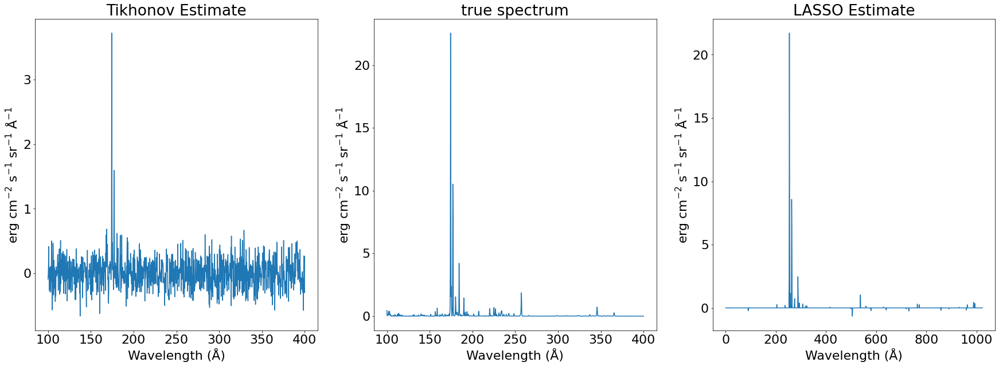

In [110]:
plot(fe10)

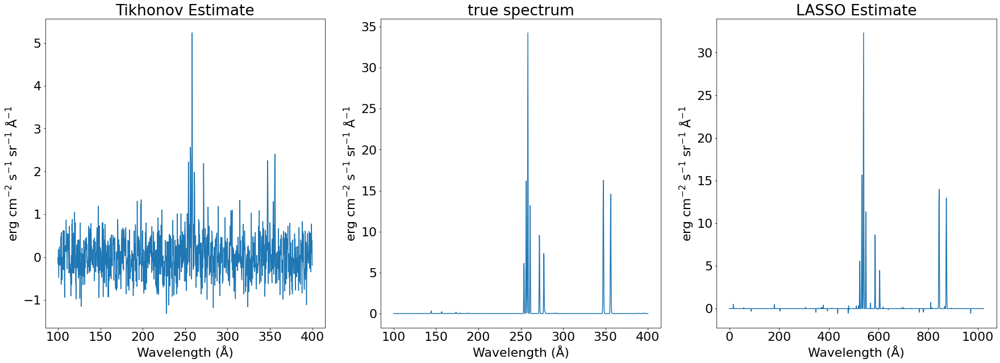

In [111]:
plot(si10)

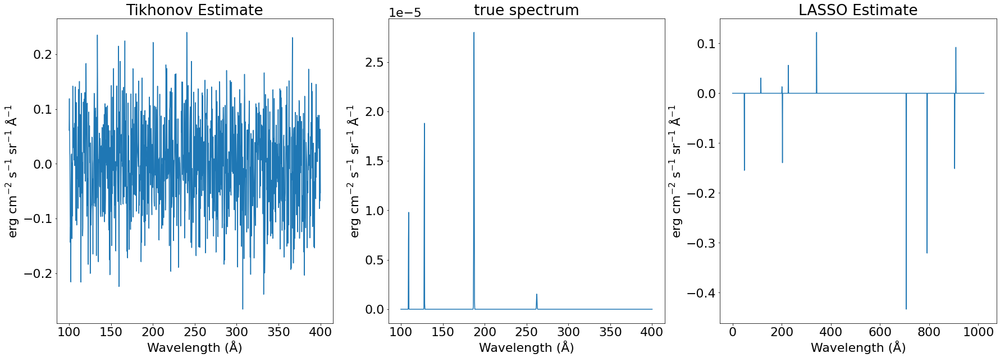

In [112]:
plot(ne10)

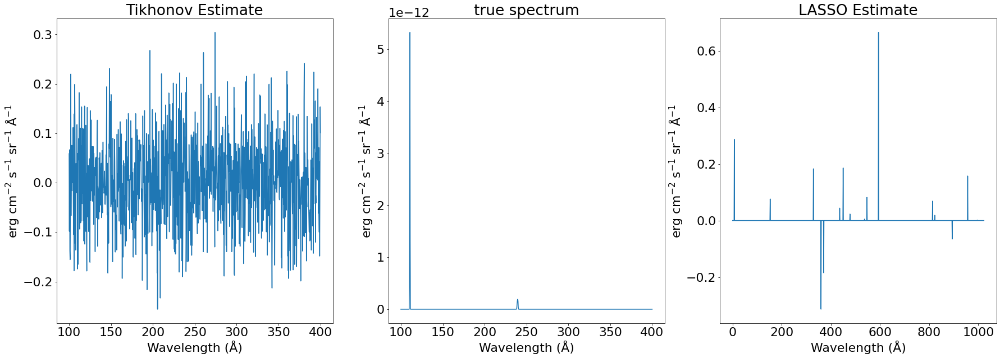

In [113]:
plot(al13)

Interesting how the LASSO estimate resulted in graphs with negative values. It also seems like a very poor estimate for spectra with few features. The TV estimate is far too noisey and eractic.

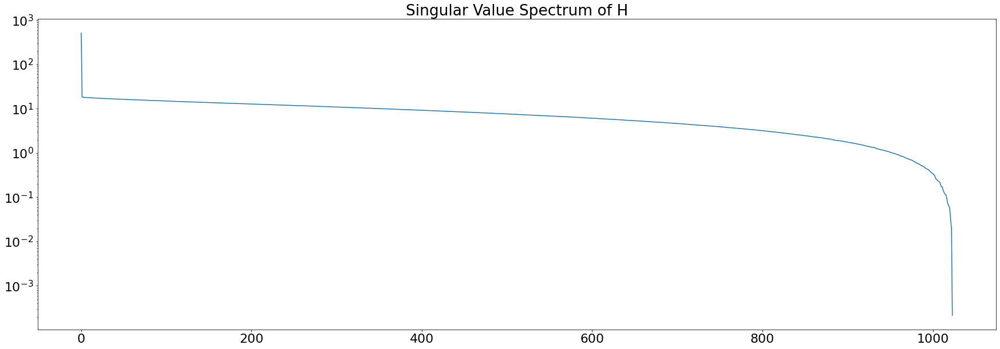

In [114]:
#
# SVD for a unipolar-random matrix of full rank
#
R=1024
H=np.random.random((R,1024))
u, lam, vh = np.linalg.svd(H)
plt.plot(lam)
plt.title('Singular Value Spectrum of H')
plt.yscale('log')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  del sys.path[0]


Text(0.5, 1.0, 'LASSO Estimate (MSE=9.130409)')

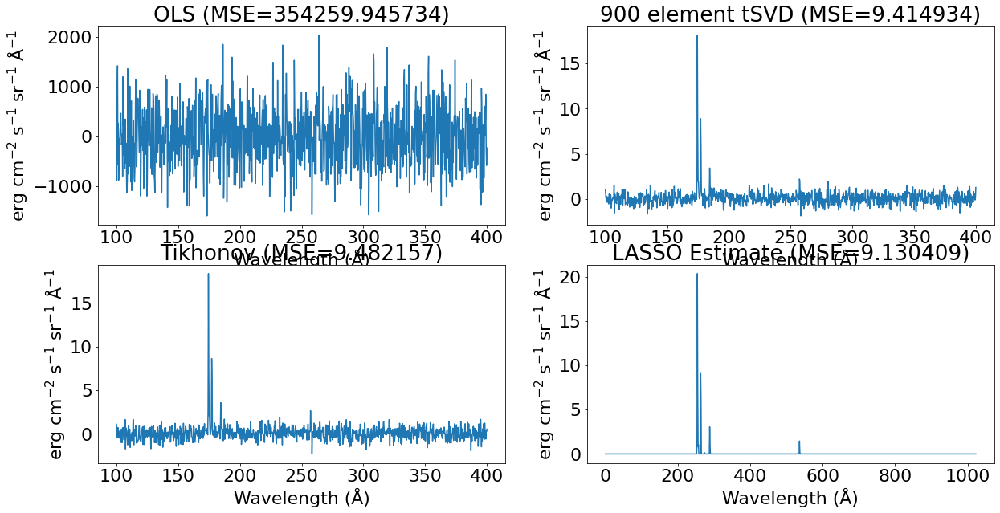

In [115]:
plt.rcParams['figure.figsize'] = [20, 10]
#
# We are considering measurements of length 1024 spectra using $m\times 1024 $ random matricies
#
noiseLevel=3
u, lam, vh = np.linalg.svd(H)
meas=np.matmul(H,fe10.Spectrum['intensity'])+noiseLevel*np.random.normal(scale=1,size=(1024))

#fig, ax = plt.subplots(nrows=2, ncols=2,figsize=(30, 10))

# OLS
plt.subplot(2,2,1)
fe=np.linalg.lstsq(H,meas)[0]
plt.plot(wvl,fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('OLS (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

# tSVD
plt.subplot(2,2,2)
reduceRank=900
Hr=np.matmul(np.matmul(np.transpose(vh[0:reduceRank,:]),np.diag(1./lam[0:reduceRank])),np.transpose(u[:,0:reduceRank]))
fe=np.matmul(Hr, meas)
plt.plot(wvl,fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('900 element tSVD (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

# Tikhonov
plt.subplot(2,2,3)
lpam=1
fe=np.matmul(np.matmul(np.linalg.pinv(np.matmul(np.transpose(H),H)+lpam**2*np.eye(1024)),np.transpose(H)), meas)
plt.plot(wvl,fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('Tikhonov (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

# LASSO
model = linear_model.Lasso(alpha=0.1)
model.fit(H,meas)
fe=model.coef_
plt.subplot(2,2,4)
plt.plot(fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('LASSO Estimate (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

The LASSO estimate is great here but it seems to break down in the next examples.

Text(0.5, 1.0, 'Singular Value Spectrum of H')

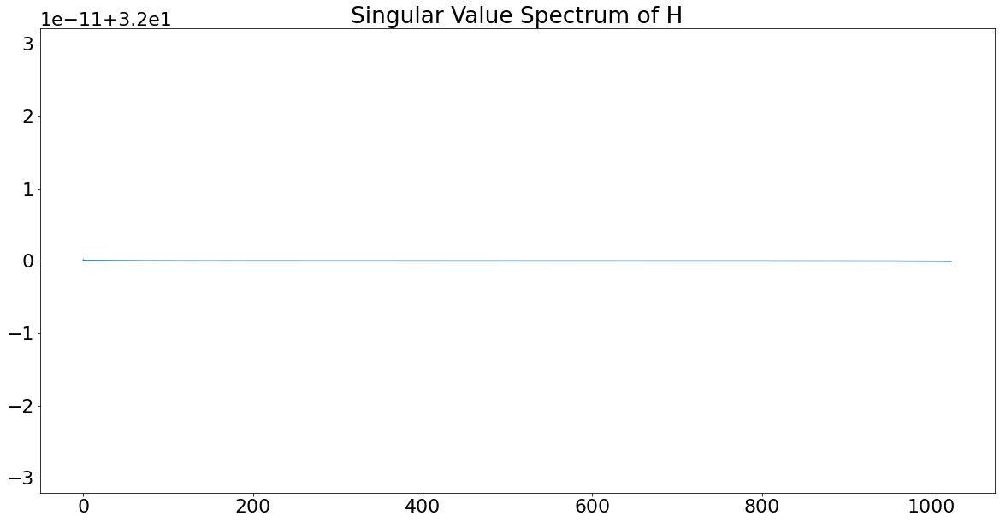

In [116]:
#
# SVD for a Hadamard matrix
#
from scipy.linalg import hadamard
R=1024
H=hadamard(R,dtype=float)
u, lam, vh = np.linalg.svd(H)
plt.plot(lam)
plt.title('Singular Value Spectrum of H')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  del sys.path[0]


Text(0.5, 1.0, 'LASSO Estimate (MSE=9.106811)')

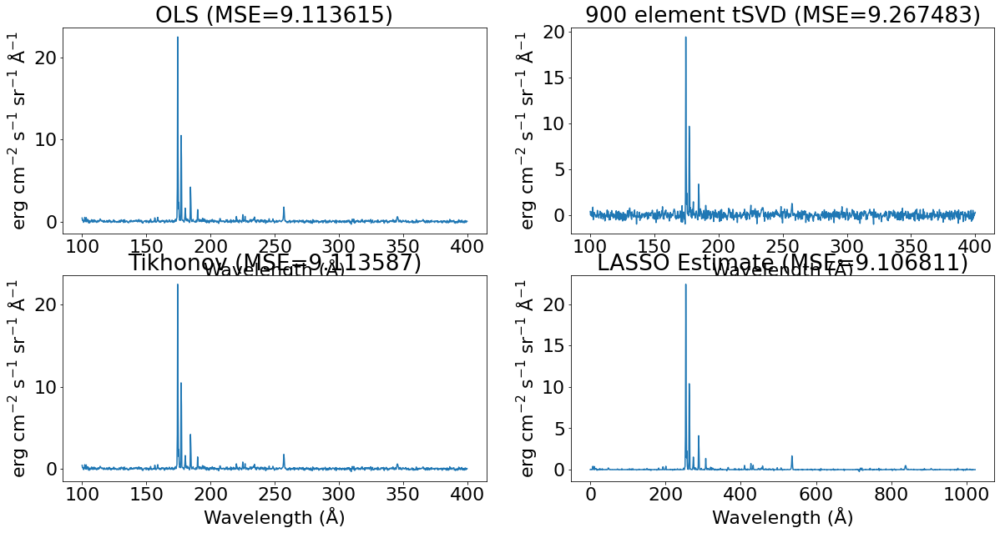

In [117]:
plt.rcParams['figure.figsize'] = [20, 10]
#
# We are considering measurements of length 1024 spectra using $m\times 1024 $ random matricies
#
noiseLevel=3
u, lam, vh = np.linalg.svd(H)
meas=np.matmul(H,fe10.Spectrum['intensity'])+noiseLevel*np.random.normal(scale=1,size=(1024))

#fig, ax = plt.subplots(nrows=2, ncols=2,figsize=(30, 10))

# OLS
plt.subplot(2,2,1)
fe=np.linalg.lstsq(H,meas)[0]
plt.plot(wvl,fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('OLS (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

# tSVD
plt.subplot(2,2,2)
reduceRank=900
Hr=np.matmul(np.matmul(np.transpose(vh[0:reduceRank,:]),np.diag(1./lam[0:reduceRank])),np.transpose(u[:,0:reduceRank]))
fe=np.matmul(Hr, meas)
plt.plot(wvl,fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('900 element tSVD (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

# Tikhonov
plt.subplot(2,2,3)
lpam=1
fe=np.matmul(np.matmul(np.linalg.pinv(np.matmul(np.transpose(H),H)+lpam**2*np.eye(1024)),np.transpose(H)), meas)
plt.plot(wvl,fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('Tikhonov (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

# LASSO
model = linear_model.Lasso(alpha=0.1)
model.fit(H,meas)
fe=model.coef_
plt.subplot(2,2,4)
plt.plot(fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('LASSO Estimate (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

Text(0.5, 1.0, 'Singular Value Spectrum of H')

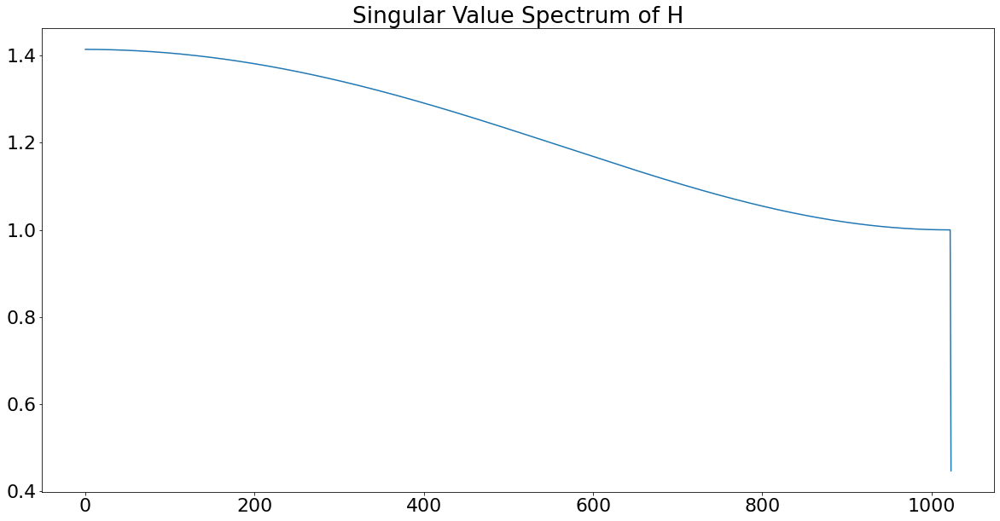

In [118]:
#
# SVD for a interpolate-by-2/averaging/upsampling matrix
#
R=1024
RR = 2*R
H=np.zeros((RR,R))

for ii in range(0,RR-2,2):
  H[ii,int(ii/2)]=1.0

for ii in range(1,RR-1,2):
  H[ii,int((ii-1)/2)]=0.5
  H[ii,int((ii+1)/2)]=0.5

u, lam, vh = np.linalg.svd(H)
plt.plot(lam)
plt.title('Singular Value Spectrum of H')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  del sys.path[0]


Text(0.5, 1.0, 'LASSO Estimate (MSE=9.891070)')

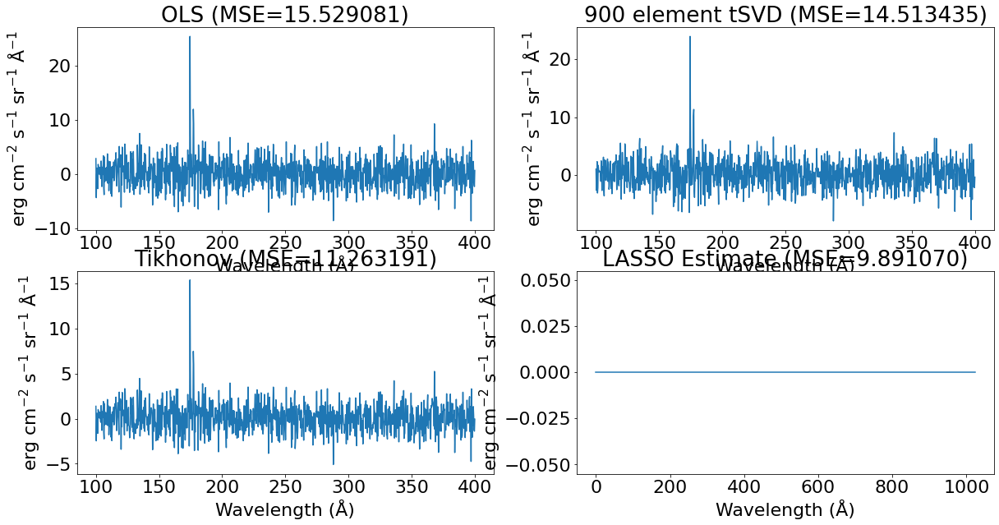

In [120]:
plt.rcParams['figure.figsize'] = [20, 10]
#
# We are considering measurements of length 1024 spectra using $m\times 1024 $ random matricies
#
noiseLevel=3
u, lam, vh = np.linalg.svd(H)
meas=np.matmul(H,fe10.Spectrum['intensity'])+noiseLevel*np.random.normal(scale=1,size=(2048))

#fig, ax = plt.subplots(nrows=2, ncols=2,figsize=(30, 10))

# OLS
plt.subplot(2,2,1)
fe=np.linalg.lstsq(H,meas)[0]
plt.plot(wvl,fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('OLS (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

# tSVD
plt.subplot(2,2,2)
reduceRank=900
Hr=np.matmul(np.matmul(np.transpose(vh[0:reduceRank,:]),np.diag(1./lam[0:reduceRank])),np.transpose(u[:,0:reduceRank]))
fe=np.matmul(Hr, meas)
plt.plot(wvl,fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('900 element tSVD (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

# Tikhonov
plt.subplot(2,2,3)
lpam=1
fe=np.matmul(np.matmul(np.linalg.pinv(np.matmul(np.transpose(H),H)+lpam**2*np.eye(1024)),np.transpose(H)), meas)
plt.plot(wvl,fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('Tikhonov (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

# LASSO
model = linear_model.Lasso(alpha=0.1)
model.fit(H,meas)
fe=model.coef_
plt.subplot(2,2,4)
plt.plot(fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('LASSO Estimate (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

Not sure why the LASSO estimate is flat...

Text(0.5, 1.0, 'Singular Value Spectrum of H')

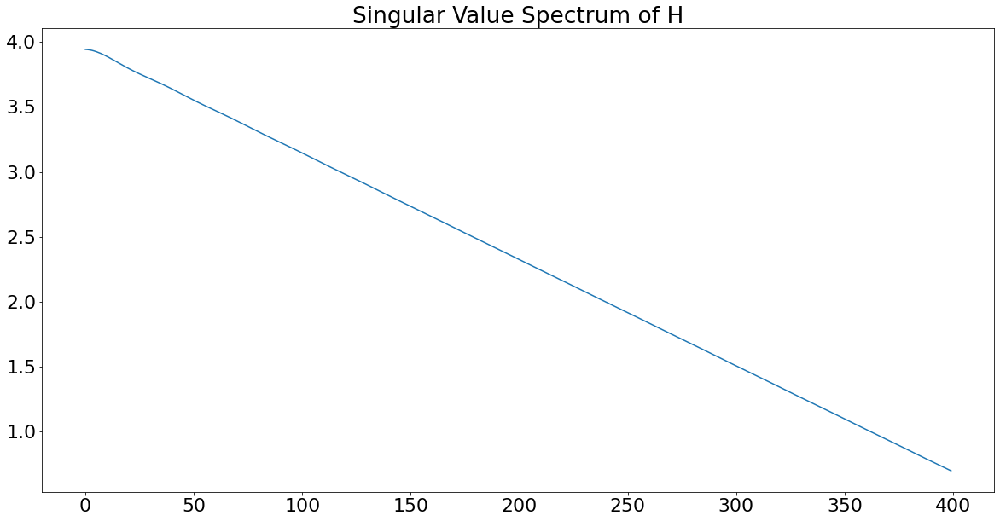

In [121]:
#
# SVD for a truncated sinc matrix
#
R=1024

psf=np.sinc(0.5*np.linspace(-32,32,128))**2

firstRow=np.concatenate((psf,np.zeros(R-len(psf))))
firstColumn=np.zeros(R)
firstColumn[0]=firstRow[0]
H=toeplitz(firstColumn,firstRow)

u, lam, vh = np.linalg.svd(H)
plt.plot(lam[0:400])
plt.title('Singular Value Spectrum of H')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  del sys.path[0]


Text(0.5, 1.0, 'LASSO Estimate (MSE=9.891070)')

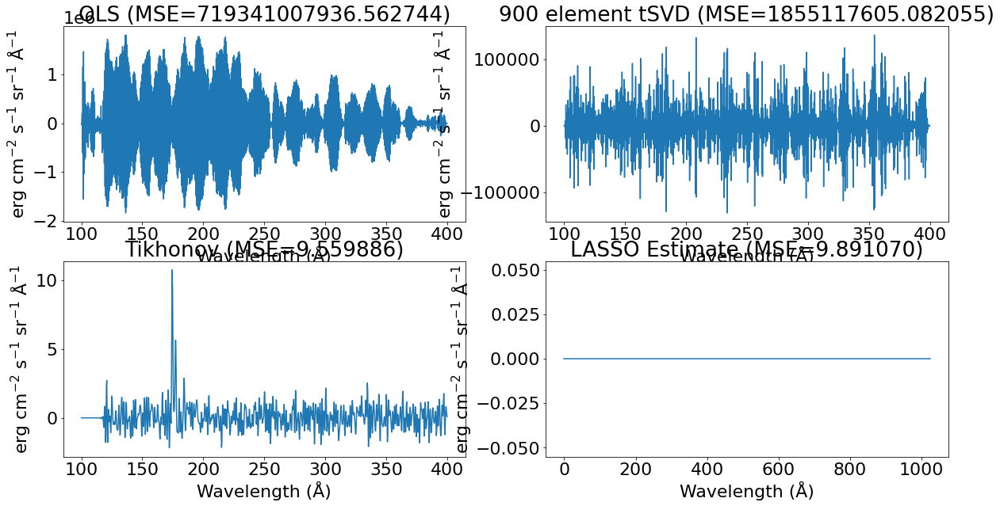

In [122]:
plt.rcParams['figure.figsize'] = [20, 10]
#
# We are considering measurements of length 1024 spectra using $m\times 1024 $ random matricies
#
noiseLevel=3
u, lam, vh = np.linalg.svd(H)
meas=np.matmul(H,fe10.Spectrum['intensity'])+noiseLevel*np.random.normal(scale=1,size=(1024))

#fig, ax = plt.subplots(nrows=2, ncols=2,figsize=(30, 10))

# OLS
plt.subplot(2,2,1)
fe=np.linalg.lstsq(H,meas)[0]
plt.plot(wvl,fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('OLS (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

# tSVD
plt.subplot(2,2,2)
reduceRank=900
Hr=np.matmul(np.matmul(np.transpose(vh[0:reduceRank,:]),np.diag(1./lam[0:reduceRank])),np.transpose(u[:,0:reduceRank]))
fe=np.matmul(Hr, meas)
plt.plot(wvl,fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('900 element tSVD (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

# Tikhonov
plt.subplot(2,2,3)
lpam=1
fe=np.matmul(np.matmul(np.linalg.pinv(np.matmul(np.transpose(H),H)+lpam**2*np.eye(1024)),np.transpose(H)), meas)
plt.plot(wvl,fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('Tikhonov (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

# LASSO
model = linear_model.Lasso(alpha=0.1)
model.fit(H,meas)
fe=model.coef_
plt.subplot(2,2,4)
plt.plot(fe)
plt.xlabel(fe10.Spectrum['xlabel'])
plt.ylabel(fe10.Spectrum['ylabel'])
plt.title('LASSO Estimate (MSE=%f)' %mean_squared_error(trueSpectrumFe10,fe))

Not sure why the LASSO estimate is flat here either. I would be interested to learn more about it to probe why it works so well at times and not at all for other cases.

#Part 3

"Consider the demosiacing neural network described in Table 3.1. Train the network as described in the text. Try to find an app for your smart phone that allows recording of raw format images. If you are unable to do this, find some raw format images online. Try to demosaic these images using the neural network, compare your results with the phone's built in demosaicing algorithm. Try improving the network of table 3.1 by adding more layers or more convolutions per layer, train the network and compare results. Compare the neural demosaicing algorithm with demosiacing built into openCV, as in the text or with other demosaicing algorithms. The main point of this exercise is to gain experience training and using neural networks, so be sure to try several different variations on the network and training strategy. Discuss your experience training the network in your report."

In [47]:
if (os.path.exists('training_data')):
  !rm -rf training_data
  
!mkdir training_data

for ii in range(18):
  os.system('wget --no-check-certificate https://github.com/sthoesen/OPTI556/raw/main/images/training_set_full%i.tar.gz' %ii)
  os.system('tar -xzvf training_set_full%i.tar.gz' %ii)
  os.system('mv training_data_full%i/* training_data/' %ii)
  os.system('rm -rf training_data_full%i' %ii)
  os.system('rm training_set_full%i.tar.gz' %ii)

In [48]:
# Generate mass array for all images to be conditioned
#12050
im=np.zeros((12050,128,128,3))
for ii in range(100,12150):
  im[ii-100,:,:,:]=io.imread('training_data/im%i.png' %ii)/255.

In [3]:
#This is the filter array for Bayer color sampling
def bayerCFA(shape,dtype='none'):
    kernel = np.array([[[1,0,0],[0,0,0]],[[0,0,0],[0,0,0]]])
    kernel = np.stack((kernel,np.array([[[0,0,0],[0,1,0]],[[0,0,0],[0,0,0]]]),np.array([[[0,0,0],[0,0,0]],[[0,1,0],[0,0,0]]]),np.array([[[0,0,0],[0,0,0]],[[0,0,0],[0,0,1]]] )),axis=-1)
    return kernel

In [45]:
# This network transforms a 32 by 32 color image into a 16 by 16 by 4 bayer sample array 
inputs = layers.Input(shape=(None,None,3))
cfa = layers.Conv2D(4, (2,2), (2,2), use_bias=False, input_shape=(32,32,3),kernel_initializer=bayerCFA)(inputs)
cfaSample=Model(inputs,cfa)

In [ ]:
trainS=10000
testS=2050
xtrain=np.zeros((trainS,64,64,4))
ytrain=np.zeros((trainS,128,128,3))
xtest=np.zeros((testS,64,64,4))
ytest=np.zeros((testS,128,128,3))
for imc in range(trainS):
  ytrain[imc,:,:,:]=im[imc,:,:,:]
  xtrain[imc,:,:,:]=cfaSample.predict(im[imc:(imc+1),:,:,:])
for imc in range(testS):
  ytest[imc,:,:,:]=im[imc+trainS,:,:,:]
  xtest[imc,:,:,:]=cfaSample.predict(im[(imc+(trainS-1)):(imc+trainS),:,:,:])
xtrain=np.reshape(xtrain, (len(xtrain), 64, 64, 4))
ytrain=np.reshape(ytrain, (len(ytrain), 128, 128, 3))
xtest=np.reshape(xtest, (len(xtest), 64, 64, 4))
ytest=np.reshape(ytest, (len(ytest), 128, 128, 3))
train_dataset = tf.data.Dataset.from_tensor_slices((xtrain, ytrain))
test_dataset = tf.data.Dataset.from_tensor_slices((xtest,ytest))
BATCH_SIZE = 32
SHUFFLE_BUFFER_SIZE = 100

train_dataset = train_dataset.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE)
test_dataset = test_dataset.batch(BATCH_SIZE)

(-0.5, 127.5, 127.5, -0.5)

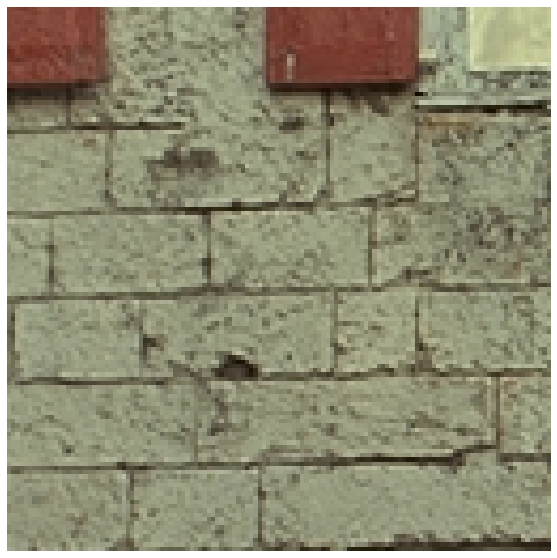

In [ ]:
plt.imshow(im[4,:,:,:])
plt.axis('off')

(-0.5, 63.5, 63.5, -0.5)

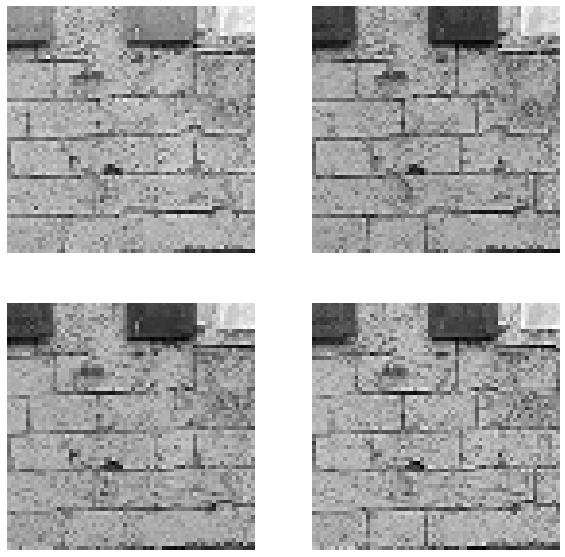

In [ ]:
#This is the filter array for Bayer color sampling
def bayerCFA(shape,dtype='none'):
    kernel = np.array([[[1,0,0],[0,0,0]],[[0,0,0],[0,0,0]]])
    kernel = np.stack((kernel,np.array([[[0,0,0],[0,1,0]],[[0,0,0],[0,0,0]]]),np.array([[[0,0,0],[0,0,0]],[[0,1,0],[0,0,0]]]),np.array([[[0,0,0],[0,0,0]],[[0,0,0],[0,0,1]]] )),axis=-1)
    return kernel
# This network transforms a 32 by 32 color image into a 16 by 16 by 4 bayer sample array 
inputs = layers.Input(shape=(None,None,3))
cfa = layers.Conv2D(4, (2,2), (2,2), use_bias=False, input_shape=(32,32,3),kernel_initializer=bayerCFA)(inputs)
cfaSample=Model(inputs,cfa)
dog=cfaSample.predict(im[4:5,:,:,:])
plt.rcParams['figure.figsize'] = [10, 10]
plt.gray()
plt.subplot(2,2,1)
plt.imshow(dog[0,:,:,0])
plt.axis('off')
plt.subplot(2,2,2)
plt.imshow(dog[0,:,:,1])
plt.axis('off')
plt.subplot(2,2,3)
plt.imshow(dog[0,:,:,2])
plt.axis('off')
plt.subplot(2,2,4)
plt.imshow(dog[0,:,:,3])
plt.axis('off')

In [ ]:
inputs = layers.Input(shape=(None,None,4))
# Encoder
x1 = layers.Conv2D(16, (2, 2), strides=2, activation="relu", padding="same")(inputs)
x = layers.MaxPooling2D((2, 2))(x1)
x2 = layers.Conv2D(32, (3, 3), activation="relu", padding="same")(x)
x3 = layers.Conv2D(64, (3, 3), strides=2, activation="relu", padding="same")(x2)
x = layers.MaxPooling2D((2, 2))(x3)
x = layers.Conv2D(128, (3, 3),  activation="relu", padding="same")(x)
# Decoder
x = layers.Conv2DTranspose(128, (3, 3), strides=2, activation="relu", padding="same")(x)

x = layers.Conv2DTranspose(32, (3, 3), strides=2, activation="relu", padding="same")(x)
x=layers.add([x,x2])
x = layers.Conv2DTranspose(16, (3, 3), strides=2, activation="relu", padding="same")(x)
x=layers.add([x,x1])
x = layers.Conv2DTranspose(4, (3, 3), strides=2, activation="relu", padding="same")(x)
x=layers.add([x,inputs])
x = layers.Conv2DTranspose(3, (3, 3), strides=2, activation="relu", padding="same")(x)
x = layers.Conv2D(3, (3, 3), activation="linear", padding="same")(x)

# Autoencoder
demosaic = Model(inputs, x)
demosaic.compile(optimizer="adam", loss="mean_squared_error")
demosaic.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, None, None,  0           []                               
                                 4)]                                                              
                                                                                                  
 conv2d_2 (Conv2D)              (None, None, None,   272         ['input_3[0][0]']                
                                16)                                                               
                                                                                                  
 max_pooling2d (MaxPooling2D)   (None, None, None,   0           ['conv2d_2[0][0]']               
                                16)                                                         

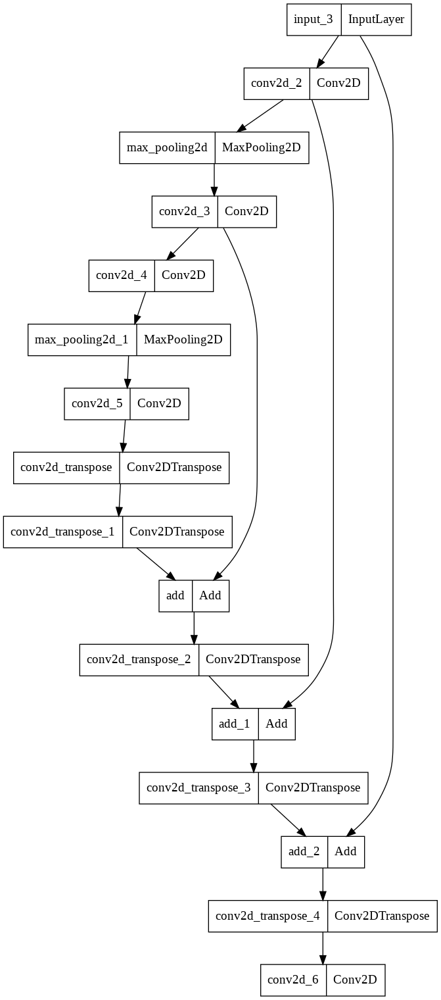

In [ ]:
keras.utils.plot_model(demosaic)

In [ ]:
demosaic.fit(train_dataset,
    epochs=50,
    batch_size=32,
    shuffle=True,
    validation_data=test_dataset
)

Epoch 1/50
313/313 [==============================] - 12s 39ms/step - loss: 0.0014 - val_loss: 0.1214
Epoch 2/50
313/313 [==============================] - 13s 43ms/step - loss: 0.0014 - val_loss: 0.1215
Epoch 3/50
313/313 [==============================] - 13s 43ms/step - loss: 0.0014 - val_loss: 0.1214
Epoch 4/50
313/313 [==============================] - 12s 39ms/step - loss: 0.0014 - val_loss: 0.1214
Epoch 5/50
313/313 [==============================] - 12s 40ms/step - loss: 0.0014 - val_loss: 0.1214
Epoch 6/50
313/313 [==============================] - 12s 37ms/step - loss: 0.0014 - val_loss: 0.1214
Epoch 7/50
313/313 [==============================] - 13s 41ms/step - loss: 0.0014 - val_loss: 0.1214
Epoch 8/50
313/313 [==============================] - 12s 39ms/step - loss: 0.0014 - val_loss: 0.1214
Epoch 9/50
313/313 [==============================] - 13s 43ms/step - loss: 0.0014 - val_loss: 0.1213
Epoch 10/50
313/313 [==============================] - 13s 43ms/step - loss: 0.001

In [ ]:
demosaic.save("demosaic50")
!tar -czvf demosaic50.tar.gz demosaic50/
files.download('demosaic50.tar.gz')

demosaic50/
demosaic50/keras_metadata.pb
demosaic50/variables/
demosaic50/variables/variables.data-00000-of-00001
demosaic50/variables/variables.index
demosaic50/assets/
demosaic50/saved_model.pb


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
dog=demosaic.predict(cfaSample.predict(im[4:5,:,:,:]))

(-0.5, 127.5, 127.5, -0.5)

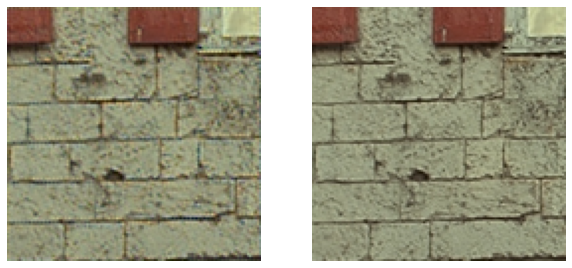

In [ ]:
plt.subplot(1,2,1)
plt.imshow(dog[0,:,:,:])
plt.axis('off')
plt.subplot(1,2,2)
plt.imshow(im[4,:,:,:])
plt.axis('off')

Here the neural demosaicing is on the left and the ground truth is on the left. The model is good but not perfect.

In [4]:
def rgb2bayerGR2(image):
  w,h, c=image.shape
  bayer=np.zeros((w,h))
  bayer[0:w:2,0:h:2]=image[0:w:2,0:h:2,1]
  bayer[1:w:2,1:h:2]=image[1:w:2,1:h:2,1]
  bayer[0:w:2,1:h:2]=image[0:w:2,1:h:2,0]
  bayer[1:w:2,0:h:2]=image[1:w:2,0:h:2,2]
  bayer=255*bayer/np.max(bayer)
  bayer=bayer.astype('uint8')
  return bayer

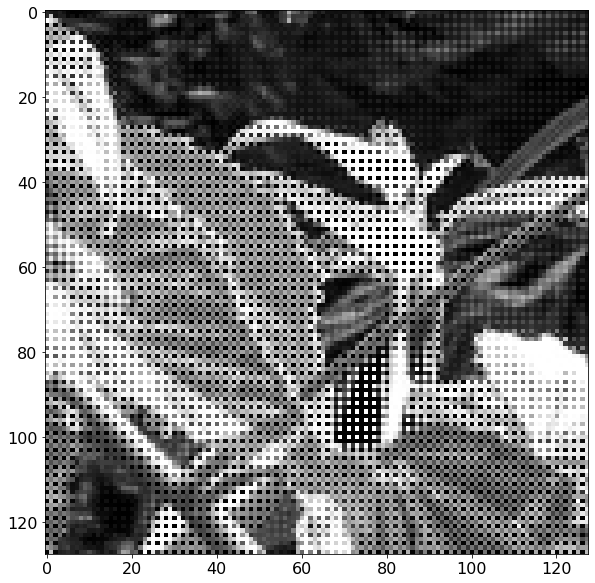

In [ ]:
plt.gray()
img=np.zeros((2,128,128,3))
img[0,:,:,:]=io.imread('training_data/im10000.png')/255.
plt.imshow(rgb2bayerGR2(img[0,:,:,:]))

(-0.5, 127.5, 127.5, -0.5)

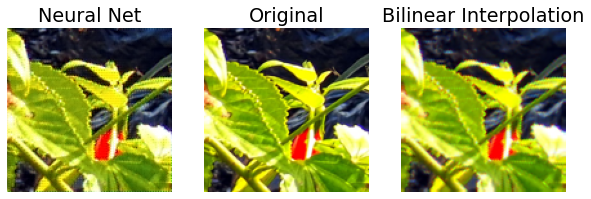

In [ ]:
plt.subplot(1,3,1)
y = demosaic.predict(cfaSample.predict(img[:,:,:,:]))
plt.imshow(y[0,:,:,:])
plt.title('Neural Net')
plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(img[0,:,:,:])
plt.title('Original')
plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(cv2.cvtColor(rgb2bayerGR2(img[0,:,:,:]), cv2.COLOR_BayerGR2BGR))
plt.title('Bilinear Interpolation')
plt.axis('off')

The neural demosicing beats out the bilinear interpolation and I think it could do better with more epochs in the training.

In [12]:
!wget --no-check-certificate --content-disposition https://github.com/Gord123098/model/raw/main/2022-09-20-0047_4-CapObj_0000.PNG

--2022-09-28 02:21:22--  https://github.com/Gord123098/model/raw/main/2022-09-20-0047_4-CapObj_0000.PNG
Resolving github.com (github.com)... 192.30.255.112
Connecting to github.com (github.com)|192.30.255.112|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/Gord123098/model/main/2022-09-20-0047_4-CapObj_0000.PNG [following]
--2022-09-28 02:21:23--  https://raw.githubusercontent.com/Gord123098/model/main/2022-09-20-0047_4-CapObj_0000.PNG
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1275814 (1.2M) [image/png]
Saving to: ‘2022-09-20-0047_4-CapObj_0000.PNG’

2022-09-20-0047_4-C 100%[===================>]   1.22M  --.-KB/s    in 0.04s   

2022-09-28 02:21:23 (29.6 MB/s) - ‘2022-09-20-0047_4-CapObj

In [14]:
raw = imread('/content/2022-09-20-0047_4-CapObj_0000.PNG')

In [16]:
def colorStack(image):
  w,h=image.shape
  cs=np.zeros((int(w/2),int(h/2),4))
  cs[:,:,3]=image[0:w:2,1:h:2]
  cs[:,:,2]=image[0:w:2,0:h:2]
  cs[:,:,1]=image[1:w:2,1:h:2]
  cs[:,:,0]=image[1:w:2,0:h:2]
  cs=cs/np.max(cs)
  cs=np.reshape(cs, (1, int(w/2), int(h/2), 4))
  return cs

In [ ]:
!wget --no-check-certificate --content-disposition https://github.com/Gord123098/model/raw/main/demosaic20.tar.gz
!tar -xzvf demosaic20.tar.gz

--2022-09-27 08:59:20--  https://github.com/Gord123098/model/raw/main/demosaic20.tar.gz
Resolving github.com (github.com)... 192.30.255.112
Connecting to github.com (github.com)|192.30.255.112|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/Gord123098/model/main/demosaic20.tar.gz [following]
--2022-09-27 08:59:21--  https://raw.githubusercontent.com/Gord123098/model/main/demosaic20.tar.gz
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3178303 (3.0M) [application/octet-stream]
Saving to: ‘demosaic20.tar.gz’

demosaic20.tar.gz   100%[===================>]   3.03M  --.-KB/s    in 0.05s   

2022-09-27 08:59:22 (63.6 MB/s) - ‘demosaic20.tar.gz’ saved [3178303/3178303]



In [ ]:
demosaic20 = keras.models.load_model('demosaic')

In [22]:
!wget --no-check-certificate --content-disposition https://github.com/Gord123098/model/raw/main/demosaic50.tar.gz

--2022-09-28 02:26:21--  https://github.com/Gord123098/model/raw/main/demosaic50.tar.gz
Resolving github.com (github.com)... 192.30.255.112
Connecting to github.com (github.com)|192.30.255.112|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/Gord123098/model/main/demosaic50.tar.gz [following]
--2022-09-28 02:26:21--  https://raw.githubusercontent.com/Gord123098/model/main/demosaic50.tar.gz
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3219482 (3.1M) [application/octet-stream]
Saving to: ‘demosaic50.tar.gz’

demosaic50.tar.gz   100%[===================>]   3.07M  --.-KB/s    in 0.04s   

2022-09-28 02:26:22 (72.7 MB/s) - ‘demosaic50.tar.gz’ saved [3219482/3219482]



In [26]:
!tar -xzvf demosaic50.tar.gz
demosaic50 = keras.models.load_model('demosaic50')

demosaic50/
demosaic50/keras_metadata.pb
demosaic50/variables/
demosaic50/variables/variables.data-00000-of-00001
demosaic50/variables/variables.index
demosaic50/assets/
demosaic50/saved_model.pb


In [30]:
raw = imread('/content/2022-09-20-0047_4-CapObj_0000.PNG')

(-0.5, 99.5, 75.5, -0.5)

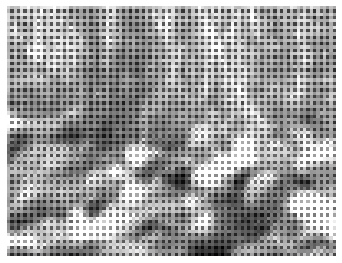

In [32]:
plt.gray()
plt.rcParams['figure.figsize'] = [20, 10]
plt.subplot(1,3,1)
plt.imshow(raw[900:1000,1000:1100])
plt.axis('off')

In [ ]:
!wget --no-check-certificate https://github.com/Gord123098/model/raw/main/DSC_0005.NEF

--2022-09-27 09:51:30--  https://github.com/Gord123098/model/raw/main/DSC_0005.NEF
Resolving github.com (github.com)... 192.30.255.112
Connecting to github.com (github.com)|192.30.255.112|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/Gord123098/model/main/DSC_0005.NEF [following]
--2022-09-27 09:51:30--  https://raw.githubusercontent.com/Gord123098/model/main/DSC_0005.NEF
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.108.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 12360472 (12M) [application/octet-stream]
Saving to: ‘DSC_0005.NEF.1’

DSC_0005.NEF.1      100%[===================>]  11.79M  --.-KB/s    in 0.07s   

2022-09-27 09:51:30 (169 MB/s) - ‘DSC_0005.NEF.1’ saved [12360472/12360472]



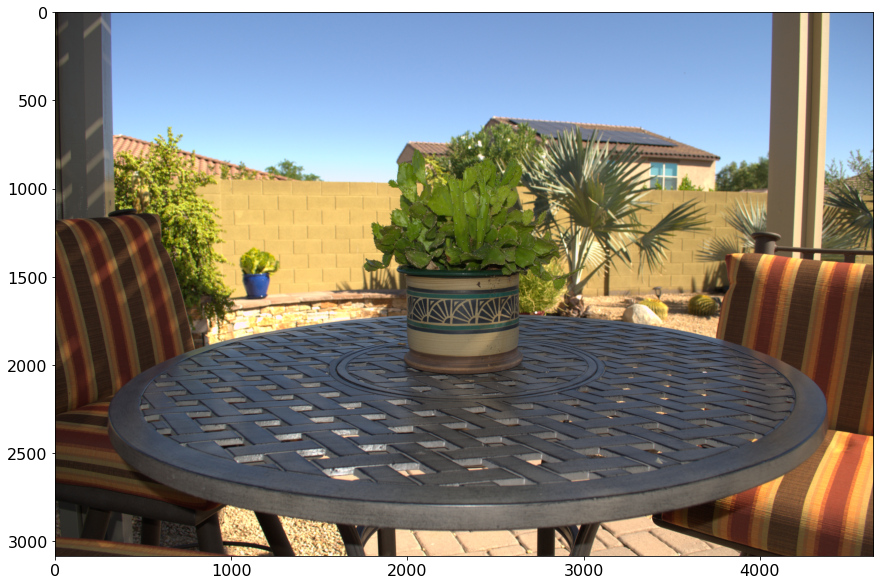

In [ ]:
raw = rawpy.imread('DSC_0005.NEF')
rawImage=raw.raw_image_visible/4095
plt.imshow(raw.postprocess())

(-0.5, 99.5, 99.5, -0.5)

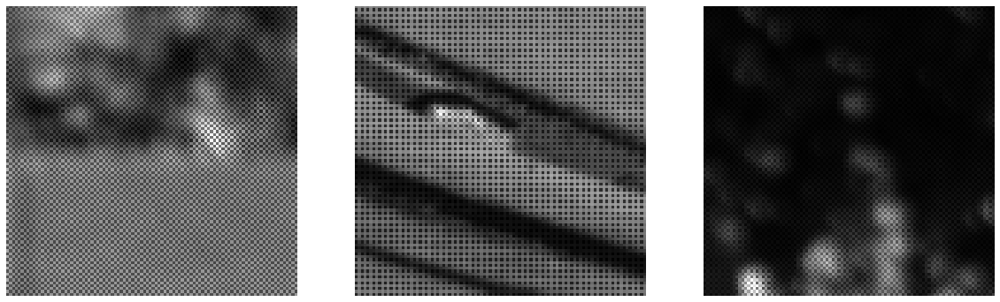

In [ ]:
plt.gray()
plt.rcParams['figure.figsize'] = [20, 10]
plt.subplot(1,3,1)
plt.imshow(rawImage[900:1000,1000:1100])
plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(rawImage[2050:2150,1700:1800])
plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(rawImage[1650:1750,850:950])
plt.axis('off')

(-0.5, 127.5, 127.5, -0.5)

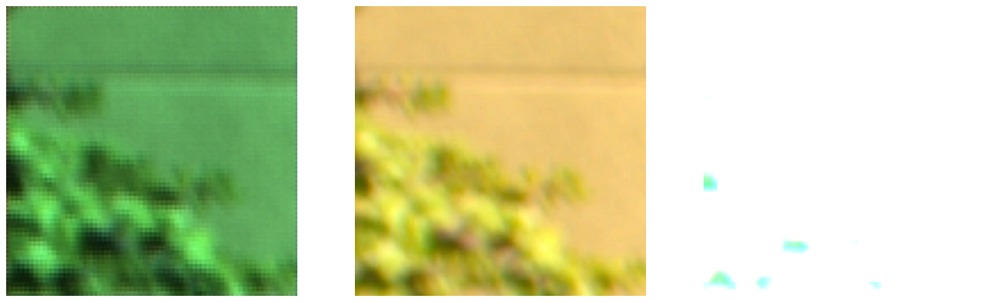

In [ ]:
cStack = np.zeros((1,64,64,4))
cStack[0,:,:,:] = colorStack(rawImage[1000:1128,800:928])
pop=demosaic50.predict(cStack)
plt.subplot(1,3,1)
plt.imshow(pop[0,:,:,:])
plt.axis('off')

plt.subplot(1,3,2)
plt.imshow((raw.postprocess())[1000:1128,800:928])
plt.axis('off')

plt.subplot(1,3,3)
plt.imshow(cv2.cvtColor((raw.raw_image_visible)[1000:1128,800:928], cv2.COLOR_BayerGR2BGR))
plt.axis('off')

####Different training below.

In [ ]:
inputs = layers.Input(shape=(None,None,4))
# Encoder
x = layers.Conv2D(8, (2, 2), strides=2, activation="relu", padding="same")(inputs)
x1 = layers.Conv2D(16, (3, 3), strides=1, activation="relu", padding="same")(x)
x = layers.MaxPooling2D((2, 2))(x1)
x = layers.Conv2D(32, (3, 3), strides=1, activation="relu", padding="same")(x)
x2 = layers.Conv2D(64, (3, 3), strides=2, activation="relu", padding="same")(x)
x = layers.MaxPooling2D((2, 2))(x2)
x = layers.Conv2D(128, (3, 3),  strides=2, activation="relu", padding="same")(x)
# Decoder
x = layers.Conv2DTranspose(128, (3, 3), strides=2, activation="relu", padding="same")(x)
x = layers.Conv2DTranspose(64, (3, 3), strides=2, activation="relu", padding="same")(x)
x=layers.add([x,x2])
x = layers.Conv2DTranspose(32, (3, 3), strides=2, activation="relu", padding="same")(x)
x = layers.Conv2DTranspose(16, (3, 3), strides=2, activation="relu", padding="same")(x)
x=layers.add([x,x1])
x = layers.Conv2DTranspose(4, (3, 3), strides=2, activation="relu", padding="same")(x)
x=layers.add([x,inputs])
x = layers.Conv2DTranspose(3, (3, 3), strides=2, activation="relu", padding="same")(x)
x = layers.Conv2D(3, (3, 3), activation="linear", padding="same")(x)

# Autoencoder
demosaic_ = Model(inputs, x)
demosaic_.compile(optimizer="adam", loss="mean_squared_error")
demosaic_.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 4)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   136         ['input_1[0][0]']                
                                8)                                                                
                                                                                                  
 conv2d_1 (Conv2D)              (None, None, None,   1168        ['conv2d[0][0]']                 
                                16)                                                           

Training with more layers.

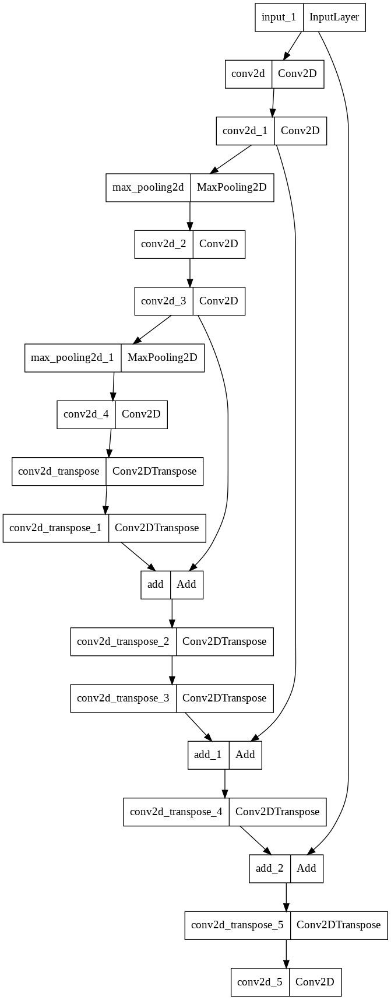

In [ ]:
keras.utils.plot_model(demosaic_)

The cell below ran and the output was saved.

In [ ]:
demosaic_.fit(train_dataset,
    epochs=100,
    batch_size=32,
    shuffle=True,
    validation_data=test_dataset
)

Epoch 1/100
313/313 [==============================] - ETA: 0s - loss: 0.0472

KeyboardInterrupt: ignored

In [ ]:
demosaic.save("demosaic_")
!tar -czvf demosaic_.tar.gz demosaic_/
files.download('demosaic_.tar.gz')

demosaic_/
demosaic_/keras_metadata.pb
demosaic_/variables/
demosaic_/variables/variables.data-00000-of-00001
demosaic_/variables/variables.index
demosaic_/assets/
demosaic_/saved_model.pb


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
!wget --no-check-certificate --content-disposition https://github.com/Gord123098/model/raw/main/demosaic_.tar.gz
!tar -xzvf demosaic_.tar.gz
demosaic_ = keras.models.load_model('demosaic')

--2022-09-27 10:14:52--  https://github.com/Gord123098/model/raw/main/demosaic_.tar.gz
Resolving github.com (github.com)... 192.30.255.113
Connecting to github.com (github.com)|192.30.255.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/Gord123098/model/main/demosaic_.tar.gz [following]
--2022-09-27 10:14:53--  https://raw.githubusercontent.com/Gord123098/model/main/demosaic_.tar.gz
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1096626 (1.0M) [application/octet-stream]
Saving to: ‘demosaic_.tar.gz.1’

demosaic_.tar.gz.1  100%[===================>]   1.04M  --.-KB/s    in 0.03s   

2022-09-27 10:14:53 (38.8 MB/s) - ‘demosaic_.tar.gz.1’ saved [1096626/1096626]

demosaic_/
demosaic_/keras_met

In [ ]:
!wget --no-check-certificate https://github.com/Gord123098/model/raw/main/DSC_0008.NEF

--2022-09-27 18:52:12--  https://github.com/Gord123098/model/raw/main/DSC_0008.NEF
Resolving github.com (github.com)... 192.30.255.112
Connecting to github.com (github.com)|192.30.255.112|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/Gord123098/model/main/DSC_0008.NEF [following]
--2022-09-27 18:52:13--  https://raw.githubusercontent.com/Gord123098/model/main/DSC_0008.NEF
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13324375 (13M) [application/octet-stream]
Saving to: ‘DSC_0008.NEF’

DSC_0008.NEF        100%[===================>]  12.71M  --.-KB/s    in 0.06s   

2022-09-27 18:52:13 (196 MB/s) - ‘DSC_0008.NEF’ saved [13324375/13324375]



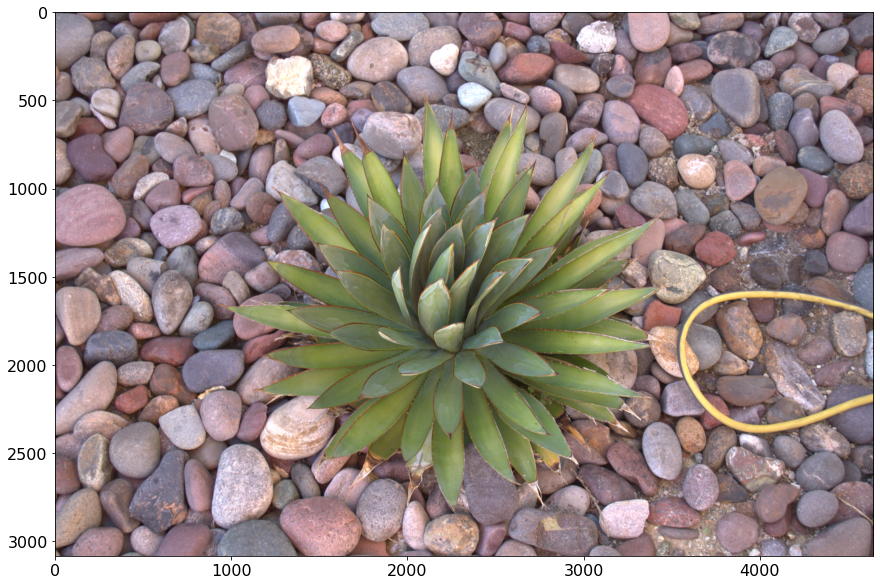

In [ ]:
raw = rawpy.imread('DSC_0008.NEF')
rawImage=raw.raw_image_visible/4095
plt.imshow(raw.postprocess())

(-0.5, 99.5, 99.5, -0.5)

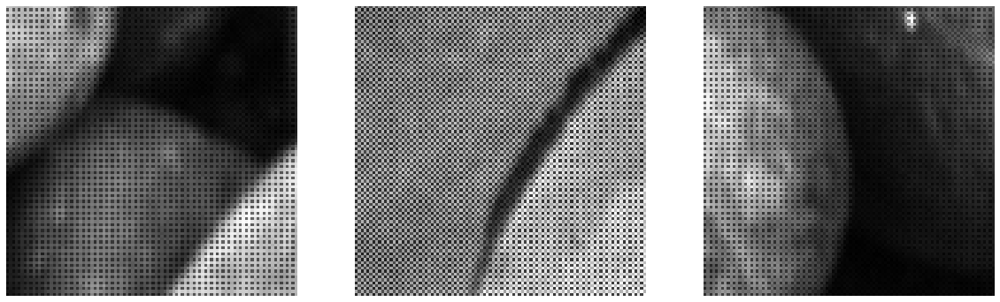

In [ ]:
plt.gray()
plt.rcParams['figure.figsize'] = [20, 10]
plt.subplot(1,3,1)
plt.imshow(rawImage[900:1000,1000:1100])
plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(rawImage[2050:2150,1700:1800])
plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(rawImage[1650:1750,850:950])
plt.axis('off')

(-0.5, 127.5, 127.5, -0.5)

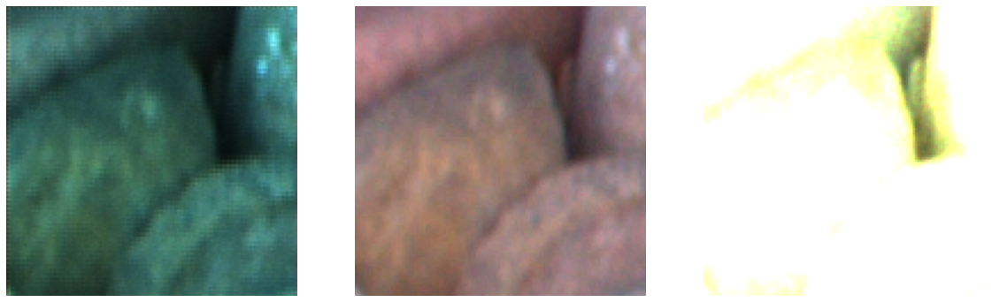

In [ ]:
cStack = np.zeros((1,64,64,4))
cStack[0,:,:,:] = colorStack(rawImage[1000:1128,800:928])
pop=demosaic50.predict(cStack)
plt.subplot(1,3,1)
plt.imshow(pop[0,:,:,:])
plt.axis('off')

plt.subplot(1,3,2)
plt.imshow((raw.postprocess())[1000:1128,800:928])
plt.axis('off')

plt.subplot(1,3,3)
plt.imshow(cv2.cvtColor((raw.raw_image_visible)[1000:1128,800:928], cv2.COLOR_BayerGR2BGR))
plt.axis('off')

Seems better after 100 epochs and a different training procedure. Let's go further.

In [ ]:
demosaic_.fit(train_dataset,
    epochs=200,
    batch_size=32,
    shuffle=True,
    validation_data=test_dataset
)

Epoch 1/200
313/313 [==============================] - 11s 34ms/step - loss: 0.0103 - val_loss: 0.1144
Epoch 2/200
313/313 [==============================] - 10s 34ms/step - loss: 0.0065 - val_loss: 0.1158
Epoch 3/200
313/313 [==============================] - 10s 33ms/step - loss: 0.0047 - val_loss: 0.1170
Epoch 4/200
313/313 [==============================] - 11s 34ms/step - loss: 0.0039 - val_loss: 0.1179
Epoch 5/200
313/313 [==============================] - 10s 33ms/step - loss: 0.0035 - val_loss: 0.1185
Epoch 6/200
313/313 [==============================] - 11s 34ms/step - loss: 0.0031 - val_loss: 0.1190
Epoch 7/200
313/313 [==============================] - 11s 34ms/step - loss: 0.0028 - val_loss: 0.1193
Epoch 8/200
313/313 [==============================] - 11s 35ms/step - loss: 0.0026 - val_loss: 0.1197
Epoch 9/200
313/313 [==============================] - 11s 34ms/step - loss: 0.0024 - val_loss: 0.1198
Epoch 10/200
313/313 [==============================] - 11s 34ms/step - l

In [ ]:
demosaic_.save("demosaic_")
!tar -czvf demosaic_.tar.gz demosaic_/
files.download('demosaic_.tar.gz')

demosaic_/
demosaic_/keras_metadata.pb
demosaic_/variables/
demosaic_/variables/variables.data-00000-of-00001
demosaic_/variables/variables.index
demosaic_/assets/
demosaic_/saved_model.pb


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [36]:
!wget --no-check-certificate --content-disposition https://github.com/Gord123098/model/raw/main/demosaic_200.tar.gz
!tar -xzvf demosaic_200.tar.gz
demosaic_ = keras.models.load_model('demosaic_')

--2022-09-28 02:32:17--  https://github.com/Gord123098/model/raw/main/demosaic_200.tar.gz
Resolving github.com (github.com)... 192.30.255.113
Connecting to github.com (github.com)|192.30.255.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/Gord123098/model/main/demosaic_200.tar.gz [following]
--2022-09-28 02:32:17--  https://raw.githubusercontent.com/Gord123098/model/main/demosaic_200.tar.gz
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3838252 (3.7M) [application/octet-stream]
Saving to: ‘demosaic_200.tar.gz.1’

demosaic_200.tar.gz 100%[===================>]   3.66M  --.-KB/s    in 0.05s   

2022-09-28 02:32:17 (76.5 MB/s) - ‘demosaic_200.tar.gz.1’ saved [3838252/3838252]

demosaic_/
demo

In [37]:
!wget --no-check-certificate https://github.com/Gord123098/model/raw/main/DSC_0004.NEF

--2022-09-28 02:33:06--  https://github.com/Gord123098/model/raw/main/DSC_0004.NEF
Resolving github.com (github.com)... 192.30.255.113
Connecting to github.com (github.com)|192.30.255.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/Gord123098/model/main/DSC_0004.NEF [following]
--2022-09-28 02:33:07--  https://raw.githubusercontent.com/Gord123098/model/main/DSC_0004.NEF
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 12699722 (12M) [application/octet-stream]
Saving to: ‘DSC_0004.NEF’

DSC_0004.NEF        100%[===================>]  12.11M  --.-KB/s    in 0.07s   

2022-09-28 02:33:07 (185 MB/s) - ‘DSC_0004.NEF’ saved [12699722/12699722]



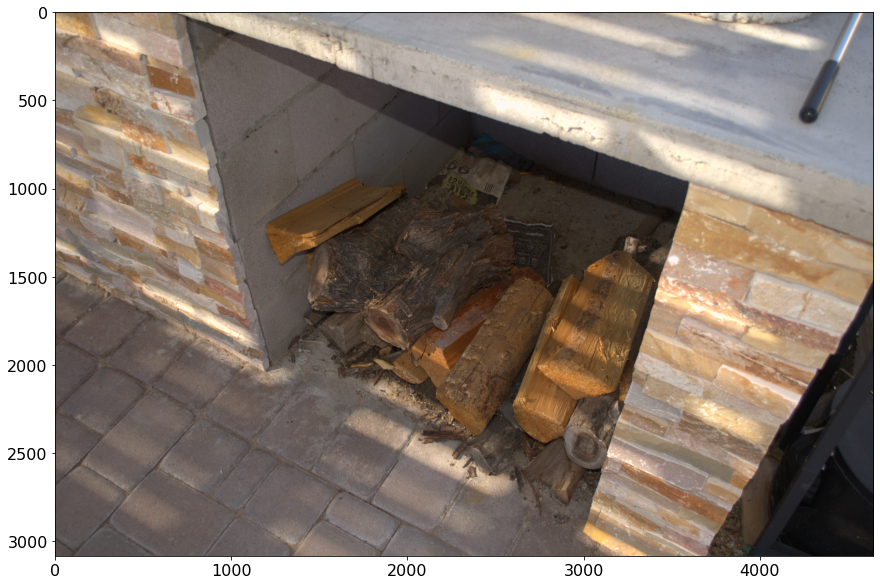

In [39]:
raw = rawpy.imread('/content/DSC_0004.NEF')
rawImage=raw.raw_image_visible/4095
plt.imshow(raw.postprocess())

(-0.5, 99.5, 99.5, -0.5)

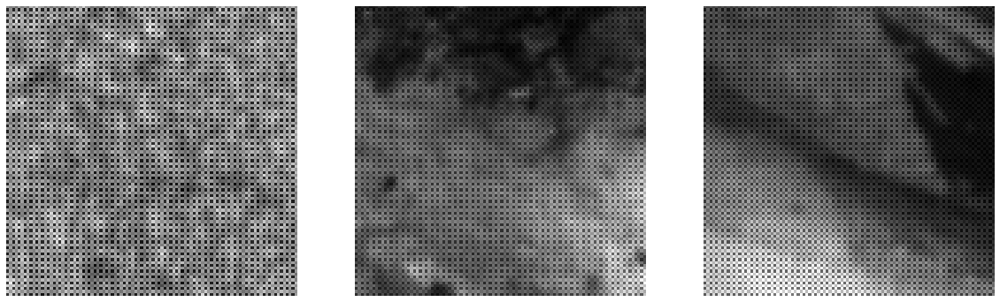

In [40]:
plt.gray()
plt.rcParams['figure.figsize'] = [20, 10]
plt.subplot(1,3,1)
plt.imshow(rawImage[900:1000,1000:1100])
plt.axis('off')
plt.subplot(1,3,2)
plt.imshow(rawImage[2050:2150,1700:1800])
plt.axis('off')
plt.subplot(1,3,3)
plt.imshow(rawImage[1650:1750,850:950])
plt.axis('off')

(-0.5, 127.5, 127.5, -0.5)

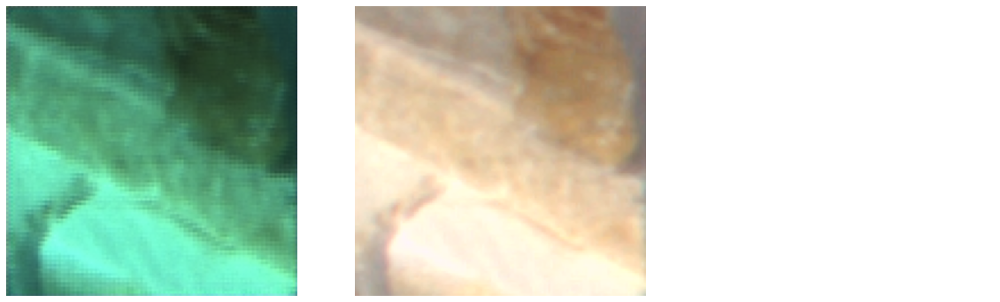

In [43]:
cStack = np.zeros((1,64,64,4))
cStack[0,:,:,:] = colorStack(rawImage[1000:1128,800:928])
pop=demosaic_.predict(cStack)
plt.subplot(1,3,1)
plt.imshow(pop[0,:,:,:])
plt.axis('off')

plt.subplot(1,3,2)
plt.imshow((raw.postprocess())[1000:1128,800:928])
plt.axis('off')

plt.subplot(1,3,3)
plt.imshow(cv2.cvtColor((raw.raw_image_visible)[1000:1128,800:928], cv2.COLOR_BayerGR2BGR))
plt.axis('off')

Seemingly little to no change. I could have done something wrong or there could be a limitation to how many epochs are usefull given a certain size training set. Additionally, the green color for the neural demosaicing on the left could be from the fact that the Nikon camera used has a CYGM filter instead of an RGB filter. This would also explain why the cv2 algorithm failed. I tried to run these scripts with images from a RGB bayer filtered astrocamera but ran into weird problems with the sizing of the images.



In [62]:
dog=demosaic_.predict(cfaSample.predict(im[509:510,:,:,:]))

(-0.5, 127.5, 127.5, -0.5)

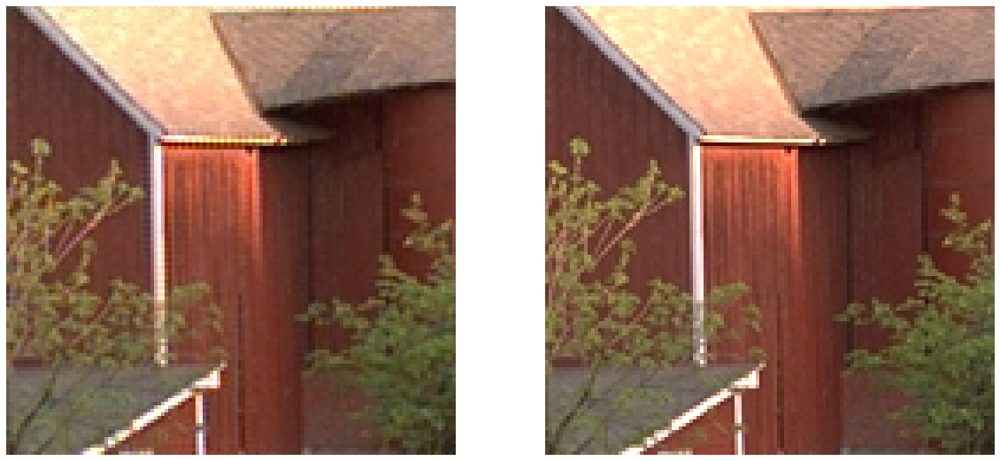

In [64]:
plt.subplot(1,2,1)
plt.imshow(dog[0,:,:,:])
plt.axis('off')
plt.subplot(1,2,2)
plt.imshow(im[509,:,:,:])
plt.axis('off')

The nueral process does not behave great around the bright straight lines in this photo.

In [67]:
dog=demosaic_.predict(cfaSample.predict(im[1010:1011,:,:,:]))

(-0.5, 127.5, 127.5, -0.5)

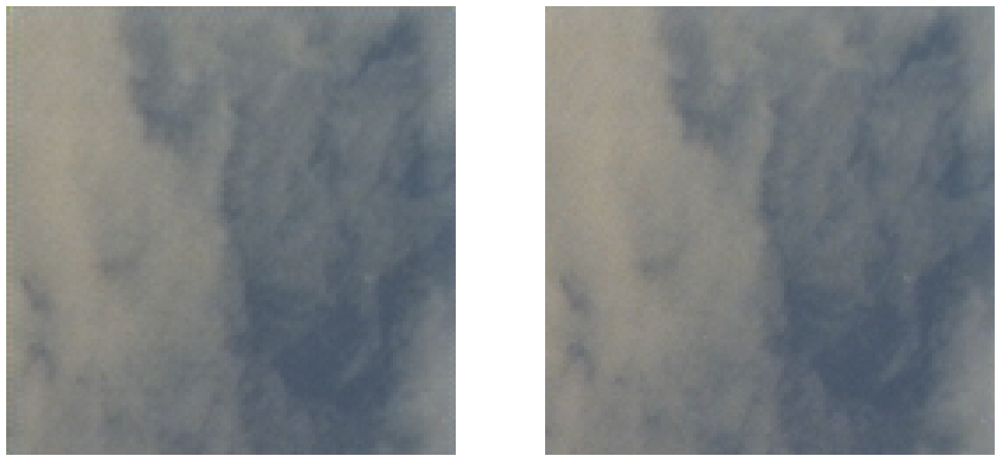

In [68]:
plt.subplot(1,2,1)
plt.imshow(dog[0,:,:,:])
plt.axis('off')
plt.subplot(1,2,2)
plt.imshow(im[1010,:,:,:])
plt.axis('off')

However, it does quite well here for irregular shapes.

In [69]:
dog=demosaic_.predict(cfaSample.predict(im[12000:12001,:,:,:]))

(-0.5, 127.5, 127.5, -0.5)

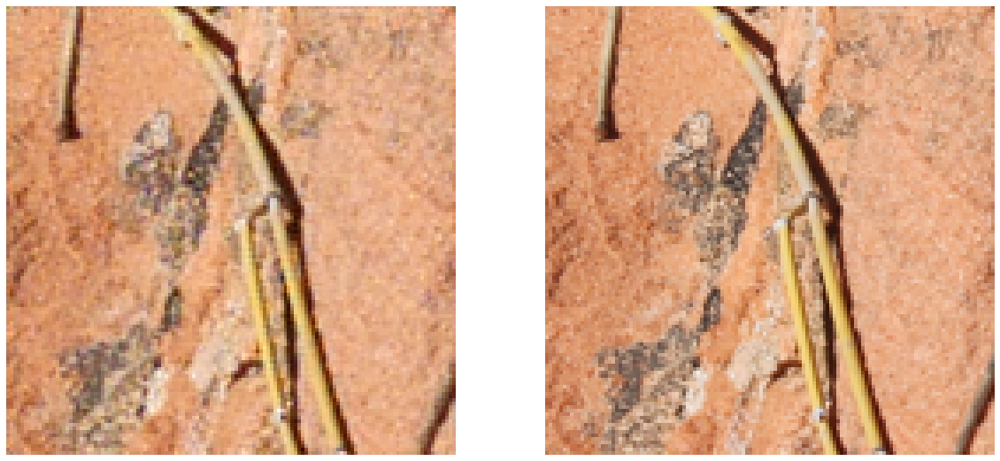

In [70]:
plt.subplot(1,2,1)
plt.imshow(dog[0,:,:,:])
plt.axis('off')
plt.subplot(1,2,2)
plt.imshow(im[12000,:,:,:])
plt.axis('off')

Here the nural process on the left seems to smooth things out too much.

In [71]:
dog=demosaic_.predict(cfaSample.predict(im[12:13,:,:,:]))

(-0.5, 127.5, 127.5, -0.5)

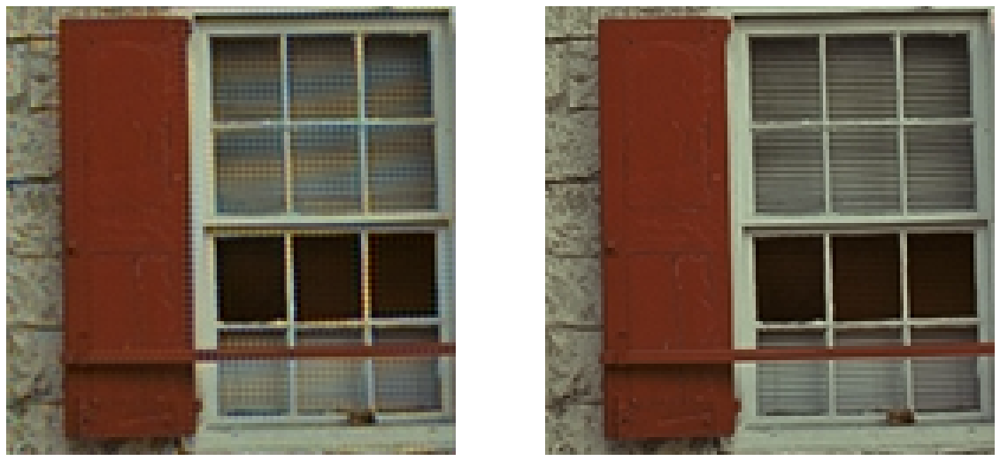

In [72]:
plt.subplot(1,2,1)
plt.imshow(dog[0,:,:,:])
plt.axis('off')
plt.subplot(1,2,2)
plt.imshow(im[12,:,:,:])
plt.axis('off')

This is an obvoius example of how the neural process adds some rainbowing in places of stripes.



The training of these different neural demosiacing models varied the convolutional layers and the number of epochs used to construct the models. Increasing the epochs seems to help the model but it is not linear, when I wnet form 20 epochs to 100 it was much better but oging from 100 to 200 had little effect. 